# Exploratory Data Analysis

# Analysis preparation

## Import packages

In [1]:
!pip install pylibjpeg
!pip install python-gdcm
!pip install plotly==5.11.0

     |████████████████████████████████| 13.0 MB 2.1 MB/s eta 0:00:01
     |████████████████████████████████| 15.3 MB 2.1 MB/s eta 0:00:01
  Attempting uninstall: plotly
    Found existing installation: plotly 5.3.1
    Uninstalling plotly-5.3.1:
      Successfully uninstalled plotly-5.3.1


In [2]:
import numpy as np
import pandas as pd
import os
from tqdm import tqdm
import pydicom
import pydicom as dcm
import seaborn as sns
import matplotlib.pyplot as plt

import os
from collections import Counter
from pathlib import Path

import plotly.express as px
from mpl_toolkits.axes_grid1 import ImageGrid
import pylibjpeg

sns.set_style("darkgrid")

## Read the data

In [3]:
train_df = pd.read_csv("/kaggle/input/rsna-breast-cancer-detection/train.csv")
test_df = pd.read_csv("/kaggle/input/rsna-breast-cancer-detection/test.csv")

# What we can learn about the data at a quick glimpse?

In [4]:
print("Train / test data shape: ", train_df.shape, test_df.shape)
print("Train images folders: ", len(os.listdir("/kaggle/input/rsna-breast-cancer-detection/train_images")))
print("Test images folders: ", len(os.listdir("/kaggle/input/rsna-breast-cancer-detection/test_images")))

Train / test data shape:  (54706, 14) (4, 9)
Train images folders:  11913
Test images folders:  1


There are 54,706 entries in the train dataset and only 11913 image folders in train_images. As the two numbers are not dividing exactly, it results that we should expect to have different number of images in the subfolders. We will get to this in a moment.

In [5]:
train_images = Path("/kaggle/input/rsna-breast-cancer-detection/train_images")
test_images = Path("/kaggle/input/rsna-breast-cancer-detection/test_images")

In [6]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54706 entries, 0 to 54705
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   site_id                  54706 non-null  int64  
 1   patient_id               54706 non-null  int64  
 2   image_id                 54706 non-null  int64  
 3   laterality               54706 non-null  object 
 4   view                     54706 non-null  object 
 5   age                      54669 non-null  float64
 6   cancer                   54706 non-null  int64  
 7   biopsy                   54706 non-null  int64  
 8   invasive                 54706 non-null  int64  
 9   BIRADS                   26286 non-null  float64
 10  implant                  54706 non-null  int64  
 11  density                  29470 non-null  object 
 12  machine_id               54706 non-null  int64  
 13  difficult_negative_case  54706 non-null  bool   
dtypes: bool(1), float64(2)

There are several columns with missing data:
* age  
* BIRADS  (meaning: Breast Imaging - Reporting and Database System)
* density  

Let's define few auxiliary functions - for missing data and for unique values.

In [7]:
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    return np.transpose(pd.concat([total, percent], axis=1, keys=['Total', 'Percent']))

In [8]:
def unique_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    uniques = []
    for col in data.columns:
        unique = data[col].nunique()
        uniques.append(unique)
    tt['Uniques'] = uniques
    return np.transpose(tt)

We look now to missing data.

In [9]:
missing_data(train_df)

,BIRADS,density,age,site_id,patient_id,image_id,laterality,view,cancer,biopsy,invasive,implant,machine_id,difficult_negative_case
Total,28420.000000,25236.000000,37.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Percent,51.950426,46.130223,0.067634,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


And to unique values.

In [10]:
unique_values(train_df)

,site_id,patient_id,image_id,laterality,view,age,cancer,biopsy,invasive,BIRADS,implant,density,machine_id,difficult_negative_case
Total,54706,54706,54706,54706,54706,54669,54706,54706,54706,26286,54706,29470,54706,54706
Uniques,2,11913,54706,2,6,63,2,2,2,3,2,4,10,2


Let's look also to the first data rows in the dataset.

In [11]:
train_df.head(6)

,site_id,patient_id,image_id,laterality,view,age,cancer,biopsy,invasive,BIRADS,implant,density,machine_id,difficult_negative_case
0,2,10006,462822612,L,CC,61.0,0,0,0,NaN,0,NaN,29,False
1,2,10006,1459541791,L,MLO,61.0,0,0,0,NaN,0,NaN,29,False
2,2,10006,1864590858,R,MLO,61.0,0,0,0,NaN,0,NaN,29,False
3,2,10006,1874946579,R,CC,61.0,0,0,0,NaN,0,NaN,29,False
4,2,10011,220375232,L,CC,55.0,0,0,0,0.0,0,NaN,21,True
5,2,10011,270344397,L,MLO,55.0,0,0,0,0.0,0,NaN,21,True


In the first 4 rows, there is data about the same patient (identified by patient_id), totally 4 images, having laterality and view with values L & R, CC & MLO respectively.

We look also to test data distribution.

In [12]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4 entries, 0 to 3
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   site_id        4 non-null      int64 
 1   patient_id     4 non-null      int64 
 2   image_id       4 non-null      int64 
 3   laterality     4 non-null      object
 4   view           4 non-null      object
 5   age            4 non-null      int64 
 6   implant        4 non-null      int64 
 7   machine_id     4 non-null      int64 
 8   prediction_id  4 non-null      object
dtypes: int64(6), object(3)
memory usage: 416.0+ bytes


Let's also look for missing data and unique values in test data.

In [13]:
missing_data(test_df)

,site_id,patient_id,image_id,laterality,view,age,implant,machine_id,prediction_id
Total,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Percent,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
unique_values(test_df)

,site_id,patient_id,image_id,laterality,view,age,implant,machine_id,prediction_id
Total,4,4,4,4,4,4,4,4,4
Uniques,1,1,4,2,2,1,1,1,2


In [15]:
test_df.head()

,site_id,patient_id,image_id,laterality,view,age,implant,machine_id,prediction_id
0,2,10008,736471439,L,MLO,81,0,21,10008_L
1,2,10008,1591370361,L,CC,81,0,21,10008_L
2,2,10008,68070693,R,MLO,81,0,21,10008_R
3,2,10008,361203119,R,CC,81,0,21,10008_R


Test data has info for only one patient. The following fields, present in train data, are not present in test data:
* cancer
* biopsy  
* invasive  
* BIRADS  
* density  
* difficult_negative_case

# Do we have images for all entries in the train data?

To check this, we compare the list of image ids in the dataset with the list of names of images in the images folders. We will also check that we do have an image folder for each patient_id.

In [16]:
file_list = []
train_path = "/kaggle/input/rsna-breast-cancer-detection/train_images"
folder_list = list(os.listdir(train_path))
for folder in tqdm(os.listdir(train_path)):
    file_list += [x.split(".dcm")[0] for x in os.listdir(os.path.join(train_path, folder))]
print(len(folder_list), len(file_list))

100%|██████████| 11913/11913 [01:02<00:00, 191.44it/s]

11913 54706


In [17]:
diff = list(set(folder_list) - set([str(x) for x in train_df.patient_id.unique()]))
print("Differences in patient/folder list: ",len(diff))

Differences in patient/folder list:  0


In [18]:
diff = list(set(file_list) - set([str(x) for x in train_df.image_id.unique()]))
print("Differences in patient/folder list: ",len(diff))

Differences in patient/folder list:  0


We can conclude that all the patients and all the images are indexed in the train dataset.  
Let's look next to the distribution of laterality and view in the patient / images set.

In [19]:
train_df.laterality.value_counts()

R    27439
L    27267
Name: laterality, dtype: int64

In [20]:
train_df.view.value_counts()

MLO    27903
CC     26765
AT        19
LM        10
ML         8
LMO        1
Name: view, dtype: int64

Overall, most of the images have at least a R and L laterality; as per view, majority will present both MLO and CC views, with a small set of patients having as well other 4 views. Let's group laterality and view to get all the combinations.

In [21]:
train_df["lv"] = train_df[["laterality", "view"]].apply(lambda x: "_".join(x), axis=1)
train_df["lv"].value_counts()

L_MLO    13958
R_MLO    13945
R_CC     13470
L_CC     13295
R_AT        12
L_AT         7
R_LM         6
R_ML         5
L_LM         4
L_ML         3
R_LMO        1
Name: lv, dtype: int64

# What are the data sources?

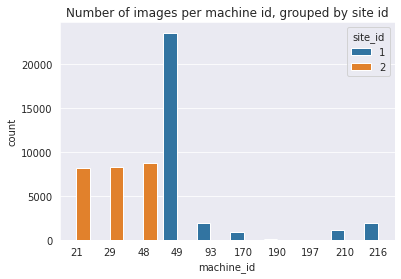

In [22]:
train_agg_df = train_df.groupby(["machine_id", "site_id"])["image_id"].count().reset_index()
train_agg_df.columns = ["machine_id", "site_id", "count"]
sns.barplot(data=train_agg_df, x="machine_id", y="count", hue="site_id")
plt.title("Number of images per machine id, grouped by site id")
plt.show()

Majority of the data sources are machine_id = 49 and site_id = 1

# What is the distribution of number of images per patient?

We already noticed that it is not a standard number of images or view and laterality distribution per patient. Let's see what is the distribution of number of images / patient.

In [23]:
train_agg_df = train_df.groupby(["patient_id"])["image_id"].count().reset_index()
train_agg_df.columns = ["patient_id", "images"]
train_agg_df.head(2)

,patient_id,images
0,5,4
1,25,6


In [24]:
train_agg_df.images.value_counts()

4     8233
5     1767
6     1218
7      276
8      229
9       99
10      53
11      19
12      12
13       5
14       2
Name: images, dtype: int64

A majority of 8,233 patients have 4 images. Then there are less and less patients with increasingly number of images. Only 2 patients have 14 images.

Let's also check how many unique laterality/view tuple have each patient.

In [25]:
train_agg_df = train_df.groupby(["patient_id"])["lv"].nunique().reset_index()
train_agg_df.columns = ["patient_id", "lat_view"]
train_agg_df.lat_view.value_counts()

4    11885
5       20
6        8
Name: lat_view, dtype: int64

From the 11913 different patients, allmost all (11,885) will have a certain combination of 4 laterality / view (with most frequent L/R , MLO / CC).

In [26]:
def plot_images_of_patient(patient_id):
    if patient_id in test_df["patient_id"]:
        print(1)
        patient_folder = test_images / f"{patient_id}"
        patient_data = test_df[test_df["patient_id"] == patient_id]
    elif patient_id in train_df["patient_id"]:
        patient_folder = train_images / f"{patient_id}"
        patient_data = train_df[train_df["patient_id"] == patient_id]
    else:
        print(f"No patient with id {patient_id}")
        return
    
    n_rows, n_cols = 2, 2
    if patient_data.shape[0] > 4:
        n_rows, n_cols = 4, 4
    if patient_data.shape[0] > 8:
        n_rows, n_clos = 8, 8
    
    fig = plt.figure(figsize=(24., 24.))
    grid = ImageGrid(fig, 111,
                     nrows_ncols=(n_rows, n_cols),
                     axes_pad=0.6,
                     )
    fig.suptitle(f"{patient_id} - {patient_data.shape[0]} images", fontsize=16)
    
    for curr_ax, curr_image in zip(grid, patient_folder.iterdir()):
        curr_image = Path(curr_image)
        image_data = patient_data[patient_data["image_id"] == int(curr_image.stem)].squeeze()
        ds = pydicom.dcmread(curr_image)
        image_as_np = ds.pixel_array.astype(np.float32)
        curr_ax.imshow(image_as_np)
        curr_ax.set_title("image_id: {}\n laterality: {}\n view {}\n machine_id {}".format(image_data["image_id"], image_data["laterality"], image_data["view"], image_data["machine_id"]), fontdict={"fontsize": 9})

And here I can visualize images of few patients

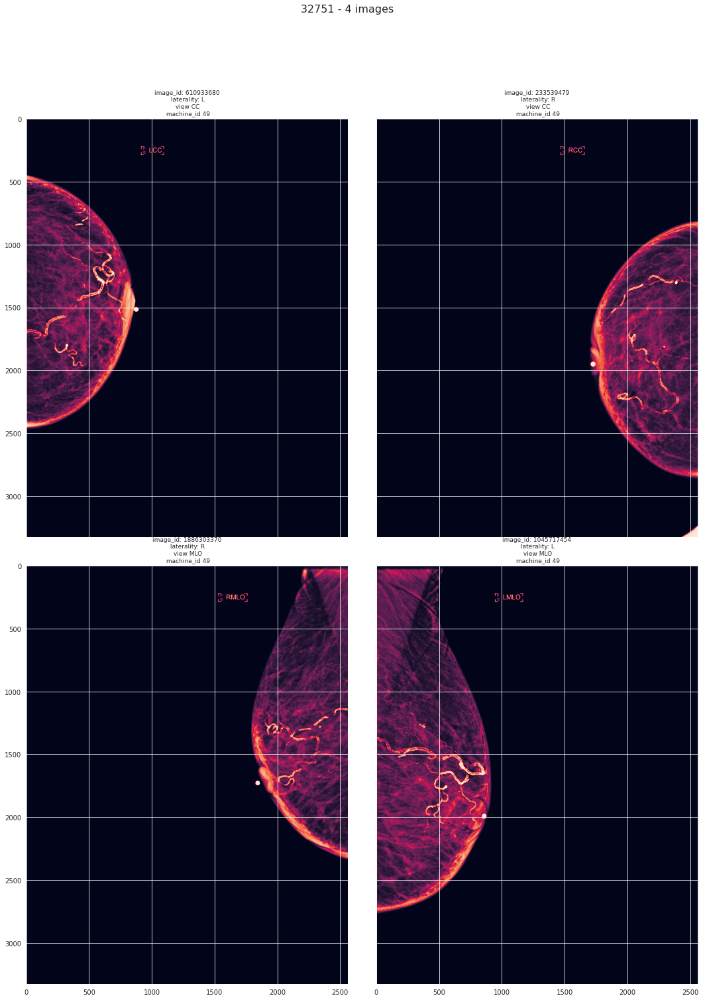

In [27]:
plot_images_of_patient(32751)

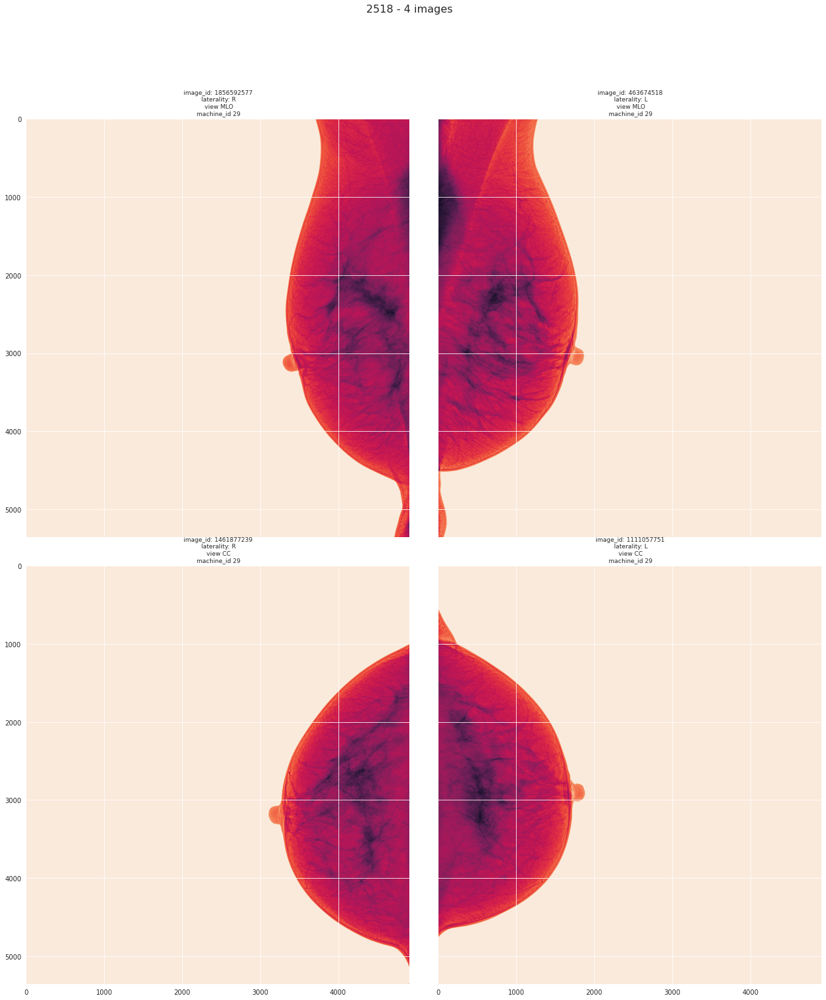

In [28]:
plot_images_of_patient(2518)

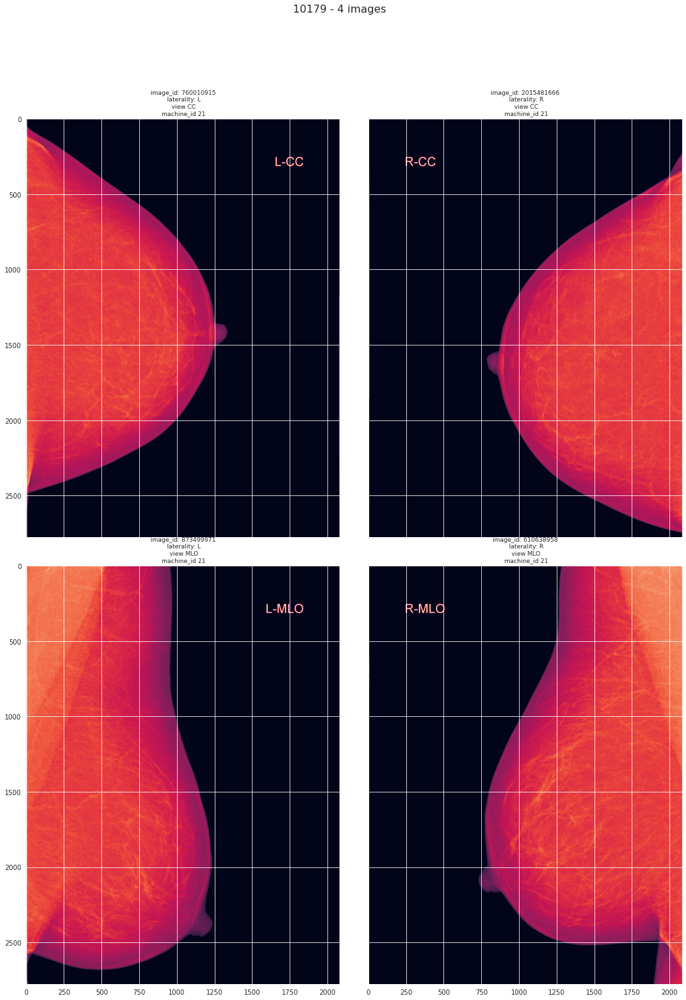

In [29]:
plot_images_of_patient(10179)

# How old are the patients? And how old are the ones with cancer?

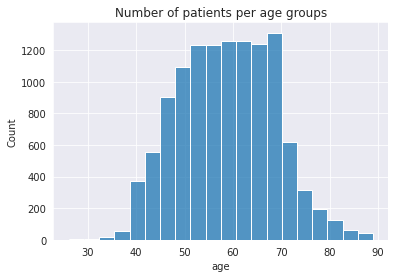

In [30]:
train_agg_df = train_df.groupby(["patient_id", "age"])["image_id"].count().reset_index()
train_agg_df.columns = ["patient", "age", "count"]
sns.histplot(train_agg_df.age, bins=20)
plt.title("Number of patients per age groups")
plt.show()

From this plot, I see, that at age of 40, more women go to mammography, and after the age of 68 begins a noticeable decrease in patients. Maybe, fewer people stay alive at this age.

Let's take only the patients with cancer.

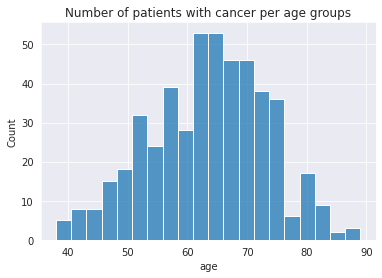

In [31]:
train_agg_df = train_df.loc[train_df.cancer==1].groupby(["patient_id", "age"])["image_id"].count().reset_index()
train_agg_df.columns = ["patient", "age", "count"]
sns.histplot(train_agg_df.age, bins=20)
plt.title("Number of patients with cancer per age groups")
plt.show()

# Are there patients that have both cancer and not cancer diagnosis?

In [32]:
train_agg_df = train_df.groupby(["patient_id", "cancer"])["image_id"].count().reset_index()
train_agg_df.columns = ["patient_id", "cancer", "count"]

print("Total cases: ", train_agg_df.shape[0])
print("Total patients: ", train_agg_df.patient_id.nunique())
print("Total cancer cases: ", train_agg_df.loc[train_agg_df.cancer==1].patient_id.nunique())
patients_with_cancer = train_agg_df.loc[train_agg_df.cancer==1].patient_id.unique()
pat_with_both = train_agg_df.loc[~train_agg_df.patient_id.isin(patients_with_cancer)].patient_id.nunique()
print("Total diagnosed without cancer: ", pat_with_both)

Total cases:  12393
Total patients:  11913
Total cancer cases:  486
Total diagnosed without cancer:  11427


In [33]:
train_agg2_df = train_agg_df.groupby(["patient_id"])["cancer"].count().reset_index()
train_agg2_df.columns = ["patient_id", "diagnoses"]
train_agg2_df.diagnoses.value_counts()

1    11433
2      480
Name: diagnoses, dtype: int64

It appears that there are 480 patients with two dignoses (cancer and not cancer), and 486 patients with cancer only. hen, there are 11433 patients with only one diagnosis, either cancer or not cancer.

# How about the patients with difficult_negative_case?

In [34]:
train_agg_df = train_df.groupby(["patient_id", "difficult_negative_case"])["image_id"].count().reset_index()
train_agg_df.columns = ["patient_id", "difficult_negative_case", "count"]
print("Total cases: ", train_agg_df.shape[0])
print("Total patients: ", train_agg_df.patient_id.nunique())
print("Total difficult_negative_case cases: ", train_agg_df.loc[train_agg_df.difficult_negative_case==1].patient_id.nunique())
patients_with_dnc = train_agg_df.loc[train_agg_df.difficult_negative_case==1].patient_id.unique()
pat_with_both = train_agg_df.loc[~train_agg_df.patient_id.isin(patients_with_dnc)].patient_id.nunique()
print("Total diagnosed without difficult_negative_case: ", pat_with_both)

Total cases:  14820
Total patients:  11913
Total difficult_negative_case cases:  3094
Total diagnosed without difficult_negative_case:  8819


# And how about patients with biopsy?

In [35]:
train_agg_df = train_df.groupby(["patient_id", "biopsy"])["image_id"].count().reset_index()
train_agg_df.columns = ["patient_id", "biopsy", "count"]
print("Total cases: ", train_agg_df.shape[0])
print("Total patients: ", train_agg_df.patient_id.nunique())
print("Total biopsy cases: ", train_agg_df.loc[train_agg_df.biopsy==1].patient_id.nunique())
patients_with_b = train_agg_df.loc[train_agg_df.biopsy==1].patient_id.unique()
pat_with_both = train_agg_df.loc[~train_agg_df.patient_id.isin(patients_with_b)].patient_id.nunique()
print("Total diagnosed without biopsy: ", pat_with_both)

Total cases:  13041
Total patients:  11913
Total biopsy cases:  1171
Total diagnosed without biopsy:  10742


# Patients with implant

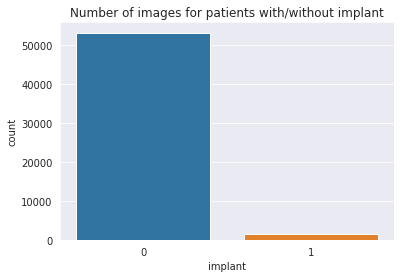

In [36]:
train_agg_df = train_df.groupby(["implant"])["image_id"].count().reset_index()
train_agg_df.columns = ["implant", "count"]
sns.barplot(data=train_agg_df, x="implant", y="count")
plt.title("Number of images for patients with/without implant")
plt.show()

# BIRADS status

BIRADS stands for Breast Imaging - Reporting and Database System.

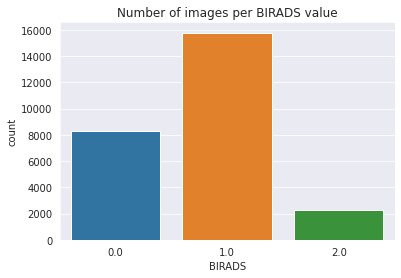

In [37]:
train_agg_df = train_df.groupby(["BIRADS"])["image_id"].count().reset_index()
train_agg_df.columns = ["BIRADS", "count"]
sns.barplot(data=train_agg_df, x="BIRADS", y="count")
plt.title("Number of images per BIRADS value")
plt.show()

# Invasive/non-invasive

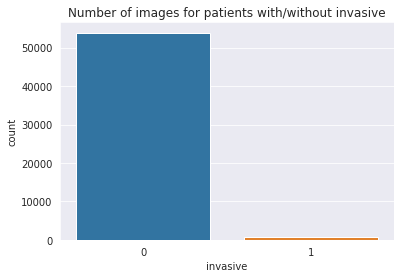

In [38]:
train_agg_df = train_df.groupby(["invasive"])["image_id"].count().reset_index()
train_agg_df.columns = ["invasive", "count"]
sns.barplot(data=train_agg_df, x="invasive", y="count")
plt.title("Number of images for patients with/without invasive")
plt.show()

# Laterality/view statistics

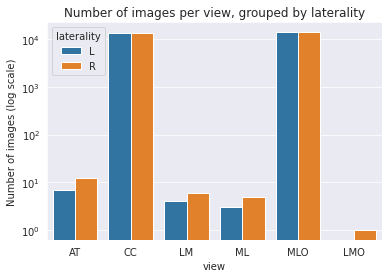

In [39]:
train_agg_df = train_df.groupby(["laterality", "view"])["image_id"].count().reset_index()
train_agg_df.columns = ["laterality", "view", "count"]
fig, ax = plt.subplots()
sns.barplot(data=train_agg_df, x="view", y="count", hue="laterality")
ax.set_yscale('log')
ax.set_ylabel('Number of images (log scale)')
plt.title("Number of images per view, grouped by laterality")
plt.show()

# Biopsy/cancer statistics

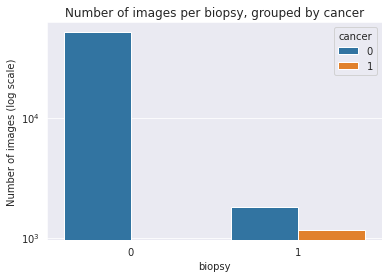

In [40]:
train_agg_df = train_df.groupby(["biopsy", "cancer"])["image_id"].count().reset_index()
train_agg_df.columns = ["biopsy", "cancer", "count"]
fig, ax = plt.subplots()
sns.barplot(data=train_agg_df, x="biopsy", y="count", hue="cancer")
ax.set_yscale('log')
ax.set_ylabel('Number of images (log scale)')
plt.title("Number of images per biopsy, grouped by cancer")
plt.show()

# Biopsy/difficult negative cases

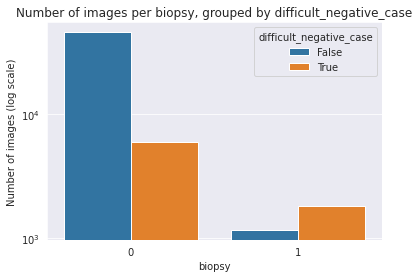

In [41]:
train_agg_df = train_df.groupby(["biopsy", "difficult_negative_case"])["image_id"].count().reset_index()
train_agg_df.columns = ["biopsy", "difficult_negative_case", "count"]
fig, ax = plt.subplots()
sns.barplot(data=train_agg_df, x="biopsy", y="count", hue="difficult_negative_case")
ax.set_yscale('log')
ax.set_ylabel('Number of images (log scale)')
plt.title("Number of images per biopsy, grouped by difficult_negative_case")
plt.show()

# Correlation Matrix

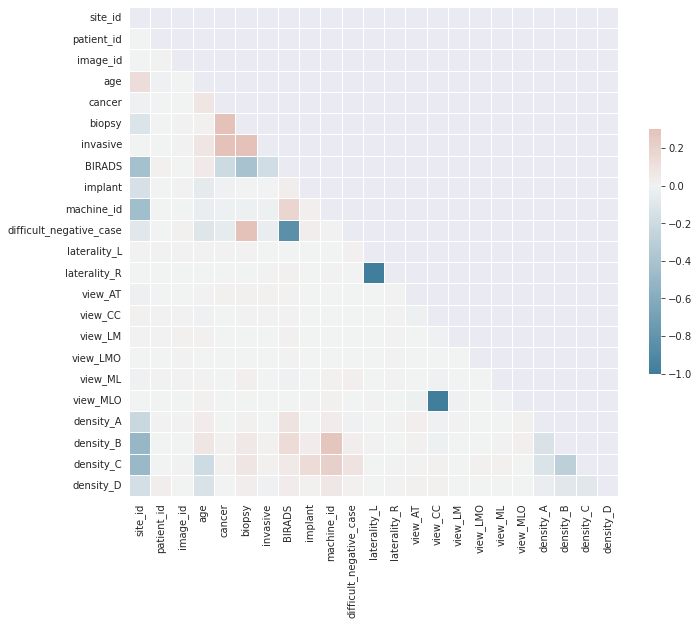

In [42]:
tmp_df = pd.concat([train_df, pd.get_dummies(train_df['laterality'], prefix='laterality'), pd.get_dummies(train_df['view'], prefix='view'), pd.get_dummies(train_df['density'], prefix='density')], axis=1)
tmp_df = tmp_df.drop(['laterality', 'view', 'density'], axis=1)
tmp_df["difficult_negative_case"] = tmp_df["difficult_negative_case"].astype(int)

corr = tmp_df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5});

# What information is in the DICOM files?

We define a function for extraction of data from DICOM format files.

In [43]:
def extract_dicom_data(data_path, patient_id):
    images_path = os.path.join(data_path,patient_id)
    for image in os.listdir(images_path):
        image_id = image.split(".dcm")[0]
        image_path = os.path.join(images_path, image)
        data_row_img_data = dcm.read_file(image_path)
        print("=================================================")
        print(f"Patient: {patient_id} Image_id: {image_id}")
        print("=================================================")
        print(data_row_img_data)
        print("=================================================\n\n")

And we test it on one patient (with 4 DICOM files).

In [44]:
patient_id = '10006'
extract_dicom_data(train_path, patient_id)

Patient: 10006 Image_id: 462822612
Dataset.file_meta -------------------------------
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: Digital X-Ray Image Storage - For Presentation
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.840.10009.1.2.3.10006.1.462822612
(0002, 0010) Transfer Syntax UID                 UI: JPEG 2000 Image Compression (Lossless Only)
(0002, 0012) Implementation Class UID            UI: 1.2.840.113654.2.3.1995.2.12.0
(0002, 0013) Implementation Version Name         SH: 'PYDICOM 2.3.0'
-------------------------------------------------
(0008, 0018) SOP Instance UID                    UI: 1.2.840.10009.1.2.3.10006.1.462822612
(0008, 0023) Content Date                        DA: '20221118'
(0008, 0033) Content Time                        TM: '183901.561976'
(0010, 0020) Patient ID                          LO: '10006'
(0020, 000d) Study Instance UID                  UI: 1.2.840.10009.1.2.3.1

# Pre-processing



This demonstrates the processing of the huge 300GB+ dataset into TFRecords for fast dataloading during training.

TFRecords have the benefit of loading large chunks of data containing many samples instead of loading every image and label seperately.

All images are resized to 1024x1024 and saved in 100 TFRecords, making each TFRecord contain roughly 550 images.



* Switching from PNG to JPEG with 95 compression level to stay within 20GB diskspace
* Adapted cropping algorithm to searches from maxima to threshold instead of edge to threshold (see Example Processing)
* Padding cropping offsets to image dimensions to keep image information instead of zero padding (see Example Processing)
* Actually using discomsdl instead of just installing it...

In [45]:
%%capture
# Source: https://www.kaggle.com/code/remekkinas/fast-dicom-processing-1-6-2x-faster?scriptVersionId=113360473
!pip install /kaggle/input/rsnamodules/dicomsdl-0.109.1-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.whl 

try:
    import pylibjpeg
except:
   !pip install /kaggle/input/rsna-2022-whl/{pylibjpeg-1.4.0-py3-none-any.whl,python_gdcm-3.0.15-cp37-cp37m-manylinux_2_17_x86_64.manylinux2014_x86_64.whl}

In [46]:
import numpy as np
import pandas as pd
import pylibjpeg
import pydicom
import matplotlib as mpl
import matplotlib.pyplot as plt
import tensorflow as tf

from joblib import Parallel, delayed
from tqdm.notebook import tqdm
from multiprocessing import cpu_count

import cv2
import glob
import importlib
import os
import joblib
import sys
import dicomsdl

print(f'Tensorflow Version: {tf.__version__}')
print(f'Python Version: {sys.version}')

# Tensorflow and CV2 set number of threads to 1 for speedup in parallell function mapping
tf.config.threading.set_inter_op_parallelism_threads(num_threads=1)
cv2.setNumThreads(1)

2023-02-22 05:08:31.145500: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:08:31.146570: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


Tensorflow Version: 2.4.1
Python Version: 3.7.10 | packaged by conda-forge | (default, Feb 19 2021, 16:07:37) 
[GCC 9.3.0]


# Config

In [47]:
# Interactive flag for debugging purposes
IS_INTERACTIVE = os.environ['KAGGLE_KERNEL_RUN_TYPE'] == 'Interactive'

# Dimensions of processed images
TARGET_HEIGHT = 1344
TARGET_WIDTH = 768
N_CHANNELS = 1
TARGET_HEIGHT_WIDTH_RATIO = TARGET_HEIGHT / TARGET_WIDTH

# Image Normalization Tools, did not improve LB score
# For a tutorial see: https://docs.opencv.org/4.x/d5/daf/tutorial_py_histogram_equalization.html
CLAHE = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(32, 32))
APPLY_CLAHE = False
APPLY_EQ_HIST = False

# Image Format and Config
IMAGE_FORMAT = 'JPG'
IMAGE_QUALITY = 95

# Random Generators Seed
SEED = 42

# Matplotlib Config

In [48]:
# MatplotLib Global Settings
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.rcParams['xtick.labelsize'] = 16
mpl.rcParams['ytick.labelsize'] = 16
mpl.rcParams['axes.labelsize'] = 18
mpl.rcParams['axes.titlesize'] = 24

# Train

In [49]:
if IS_INTERACTIVE:
    train = pd.read_csv('/kaggle/input/rsna-breast-cancer-detection/train.csv').head(1024)
else:
    train = pd.read_csv('/kaggle/input/rsna-breast-cancer-detection/train.csv')
    
def get_file_path(args):
    patient_id, image_id = args
    return f'/kaggle/input/rsna-breast-cancer-detection/train_images/{patient_id}/{image_id}.dcm'
    
train['file_path'] = train[['patient_id', 'image_id']].apply(get_file_path, axis=1)
    
display(train.info())
display(train.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1024 entries, 0 to 1023
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   site_id                  1024 non-null   int64  
 1   patient_id               1024 non-null   int64  
 2   image_id                 1024 non-null   int64  
 3   laterality               1024 non-null   object 
 4   view                     1024 non-null   object 
 5   age                      1024 non-null   float64
 6   cancer                   1024 non-null   int64  
 7   biopsy                   1024 non-null   int64  
 8   invasive                 1024 non-null   int64  
 9   BIRADS                   470 non-null    float64
 10  implant                  1024 non-null   int64  
 11  density                  548 non-null    object 
 12  machine_id               1024 non-null   int64  
 13  difficult_negative_case  1024 non-null   bool   
 14  file_path               

None

,site_id,patient_id,image_id,laterality,view,age,cancer,biopsy,invasive,BIRADS,implant,density,machine_id,difficult_negative_case,file_path
0,2,10006,462822612,L,CC,61.0,0,0,0,NaN,0,NaN,29,False,/kaggle/input/rsna-breast-cancer-detection/tra...
1,2,10006,1459541791,L,MLO,61.0,0,0,0,NaN,0,NaN,29,False,/kaggle/input/rsna-breast-cancer-detection/tra...
2,2,10006,1864590858,R,MLO,61.0,0,0,0,NaN,0,NaN,29,False,/kaggle/input/rsna-breast-cancer-detection/tra...
3,2,10006,1874946579,R,CC,61.0,0,0,0,NaN,0,NaN,29,False,/kaggle/input/rsna-breast-cancer-detection/tra...
4,2,10011,220375232,L,CC,55.0,0,0,0,0.0,0,NaN,21,True,/kaggle/input/rsna-breast-cancer-detection/tra...


# VOI_LUT

In [50]:
# Source: https://www.kaggle.com/code/bobdegraaf/dicomsdl-voi-lut
def voi_lut(image, dicom):
    # Load only the variables we need
    center = dicom['WindowCenter']
    width = dicom['WindowWidth']
    bits_stored = dicom['BitsStored']
    voi_lut_function = dicom['VOILUTFunction']

    # For sigmoid it's a list, otherwise a single value
    if isinstance(center, list):
        center = center[0]
    if isinstance(width, list):
        width = width[0]

    # Set y_min, max & range
    y_min = 0
    y_max = float(2**bits_stored - 1)
    y_range = y_max

    # Function with default LINEAR (so for Nan, it will use linear)
    if voi_lut_function == 'SIGMOID':
        image = y_range / (1 + np.exp(-4 * (image - center) / width)) + y_min
    else:
        # Checks width for < 1 (in our case not necessary, always >= 750)
        center -= 0.5
        width -= 1

        below = image <= (center - width / 2)
        above = image > (center + width / 2)
        between = np.logical_and(~below, ~above)

        image[below] = y_min
        image[above] = y_max
        if between.any():
            image[between] = (
                ((image[between] - center) / width + 0.5) * y_range + y_min
            )

    # Normalize to have 0 as background, some images are reversed where 0 is max intensity
    if dicom['PhotometricInterpretation'] == 'MONOCHROME1':
        image = np.max(image) - image

    return image

# Crop Image

In [51]:
# Smooth vector used to smoothen sums/stds of axes
def smooth(l):
    # kernel size is 1% of vector
    kernel_size = int(len(l) * 0.01)
    kernel = np.ones(kernel_size) / kernel_size
    return np.convolve(l, kernel, mode='same')

# X Crop offset based on first column with sum below 5% of maximum column sums*std
def get_x_offset(image, max_col_sum_ratio_threshold=0.05, debug=None):
    # Image Dimensions
    H, W = image.shape
    # Percentual margin added to offset
    margin = int(image.shape[1] * 0.00)
    # Threshold values based on smoothed sum x std to capture varying intensity columns
    vv = smooth(image.sum(axis=0).squeeze()) * smooth(image.std(axis=0).squeeze())
    # Find maximum sum in first 75% of columns
    vv_argmax = vv[:int(image.shape[1] * 0.75)].argmax()
    # Threshold value
    vv_threshold = vv.max() * max_col_sum_ratio_threshold
    
    # Find first column after maximum column below threshold value
    for offset, v in enumerate(vv):
        # Start searching from vv_argmax
        if offset < vv_argmax:
            continue
        
        # Column below threshold value found
        if v < vv_threshold:
            offset = min(W, offset + margin)
            break
            
    if isinstance(debug, np.ndarray):
        debug[1].imshow(image)
        debug[1].set_title('X Offset')
        vv_scale = H / vv.max() * 0.90
        # Values
        debug[1].plot(H - vv * vv_scale , c='red', label='vv')
        # Threshold
        debug[1].hlines(H - vv_threshold * vv_scale, 0, W -1, colors='orange', label='threshold')
        # Max Value
        debug[1].scatter(vv_argmax, H - vv[vv_argmax] * vv_scale, c='blue', s=100, label='Max', zorder=np.PINF)
        # First Column Below Threshold
        debug[1].scatter(offset, H - vv[offset] * vv_scale, c='purple', s=100, label='Offset', zorder=np.PINF)
        debug[1].set_ylim(H, 0)
        debug[1].legend()
        debug[1].axis('off')
        
    return offset

# Y Crop offset based on first bottom and top rows with sum below 10% of maximum row sum*std
def get_y_offsets(image, max_row_sum_ratio_threshold=0.10, debug=None):
    # Image Dimensions
    H, W = image.shape
    # Margin to add to offsets
    margin = 0
    # Threshold values based on smoothed sum x std to capture varying intensity columns
    vv = smooth(image.sum(axis=1).squeeze()) * smooth(image.std(axis=1).squeeze())
    # Find maximum sum * std row in inter quartile rows
    vv_argmax = int(image.shape[0] * 0.25) + vv[int(image.shape[0] * 0.25):int(image.shape[0] * 0.75)].argmax()
    # Threshold value
    vv_threshold = vv.max() * max_row_sum_ratio_threshold
    # Default crop offsets
    offset_bottom = 0
    offset_top = H

    # Bottom offset, search from argmax to bottom
    for offset in reversed(range(0, vv_argmax)):
        v = vv[offset]
        if v < vv_threshold:
            offset_bottom = offset
            break
    
    if isinstance(debug, np.ndarray):
        debug[2].imshow(image)
        debug[2].set_title('Y Bottom Offset')
        vv_scale = W / vv.max() * 0.90
        # Values
        debug[2].plot(vv * vv_scale, np.arange(H), c='red', label='vv')
        # Threshold
        debug[2].vlines(vv_threshold * vv_scale, 0, H -1, colors='orange', label='threshold')
        # Max Value
        debug[2].scatter(vv[vv_argmax] * vv_scale, vv_argmax, c='blue', s=100, label='Max', zorder=np.PINF)
        # First Column Below Threshold
        debug[2].scatter(vv[offset_bottom] * vv_scale, offset_bottom, c='purple', s=100, label='Offset', zorder=np.PINF)
        debug[2].set_ylim(H, 0)
        debug[2].legend()
        debug[2].axis('off')
            
    # Top offset, search from argmax to top
    for offset in range(vv_argmax, H):
        v = vv[offset]
        if v < vv_threshold:
            offset_top = offset
            break
            
    if isinstance(debug, np.ndarray):
        debug[3].imshow(image)
        debug[3].set_title('Y Top Offset')
        vv_scale = W / vv.max() * 0.90
        # Values
        debug[3].plot(vv * vv_scale, np.arange(H) , c='red', label='vv')
        # Threshold
        debug[3].vlines(vv_threshold * vv_scale, 0, H -1, colors='orange', label='threshold')
        # Max Value
        debug[3].scatter(vv[vv_argmax] * vv_scale, vv_argmax, c='blue', s=100, label='Max', zorder=np.PINF)
        # First Column Below Threshold
        debug[3].scatter(vv[offset_top] * vv_scale, offset_top, c='purple', s=100, label='Offset', zorder=np.PINF)
        debug[2].set_ylim(H, 0)
        debug[3].legend()
        debug[3].axis('off')
            
    return max(0, offset_bottom - margin), min(image.shape[0], offset_top + margin)

# Crop image and pad offsets to target image height/width ratio to preserve information
def crop(image, size=None, debug=False):
    # Image dimensions
    H, W = image.shape
    # Compute x/bottom/top offsets
    x_offset = get_x_offset(image, debug=debug)
    offset_bottom, offset_top = get_y_offsets(image[:,:x_offset], debug=debug)
    # Crop Height and Width
    h_crop = offset_top - offset_bottom
    w_crop = x_offset
    
    # Pad crop offsets to target aspect ratio
    if size is not None:
        # Height too large, pad x offset
        if (h_crop / w_crop) > TARGET_HEIGHT_WIDTH_RATIO:
            x_offset += int(h_crop / TARGET_HEIGHT_WIDTH_RATIO - w_crop)
        else:
            # Height too small, pad bottom/top offsets
            offset_bottom -= int(0.50 * (w_crop * TARGET_HEIGHT_WIDTH_RATIO - h_crop))
            offset_bottom_correction = max(0, -offset_bottom)
            offset_bottom += offset_bottom_correction

            offset_top += int(0.50 * (w_crop * TARGET_HEIGHT_WIDTH_RATIO - h_crop))
            offset_top += offset_bottom_correction
        
    # Crop Image
    image = image[offset_bottom:offset_top:,:x_offset]
        
    return image

# Utility

In [52]:
# based on: https://www.kaggle.com/code/remekkinas/fast-dicom-processing-1-6-2x-faster?scriptVersionId=113360473
def process(file_path, size=None, dicom_process=True, ret_target=False, crop_image=False, apply_clahe=APPLY_CLAHE, apply_eq_hist=APPLY_EQ_HIST, debug=False):
    # Read Dicom File
    dicom = dicomsdl.open(file_path)
    image = dicom.pixelData()
    
    # Save original image for debug purposes
    if debug:
        fig, axes = plt.subplots(1, 5, figsize=(20,10))
        image0 = np.copy(image)
        axes[0].imshow(image0)
        axes[0].set_title('Original Image')
        axes[0].axis('off')
    else:
        axes = False
        
    # voi_lut
    image = voi_lut(image, dicom)

    # Normalize [0,1] range
    image = (image - image.min()) / (image.max() - image.min())

    # Convert to uint8 image in range [0, 255]
    image = (image * 255).astype(np.uint8)
    
    # Normalize to left/right orientation by flipping right/left oriented images
    h0, w0 = image.shape
    if image[:,int(-w0 * 0.10):].sum() > image[:,:int(w0 * 0.10)].sum():
        image = np.flip(image, axis=1)
    
    if crop_image:
        image = crop(image, size=size, debug=axes)
    
    # Resize
    if size is not None:
        # Pad black pixels to get correct image ratios
        h, w = image.shape
        if (h / w) > TARGET_HEIGHT_WIDTH_RATIO:
            pad = int(h / TARGET_HEIGHT_WIDTH_RATIO - w)
            image = np.pad(image, [[0,0], [0, pad]])
            h, w = image.shape
        else:
            pad = int(0.50 * (w * TARGET_HEIGHT_WIDTH_RATIO - h))
            image = np.pad(image, [[pad, pad], [0,0]])
            h, w = image.shape
        # Resize
        image = cv2.resize(image, size, interpolation=cv2.INTER_AREA)
        
    # Apply CLAHE contrast enhancement
    # https://docs.opencv.org/4.x/d5/daf/tutorial_py_histogram_equalization.html
    if apply_clahe:
        image = CLAHE.apply(image)
        
    # Apply Histogram Equalization
    # https://docs.opencv.org/4.x/d5/daf/tutorial_py_histogram_equalization.html
    if apply_eq_hist:
        image = cv2.equalizeHist(image)
        
    if debug:
        axes[4].imshow(image)
        axes[4].set_title('Processed Image')
        axes[4].axis('off')
        plt.show()

    # Return Cancer Target
    if ret_target:
        patient_id = int(file_path.split('/')[-2])
        image_id = int(file_path.split('/')[-1].split('.')[0])

        target = PATIENT_ID_IMAGE_ID2CANCER[(patient_id, image_id)]
        
        return image, target
    # Return image Only
    else:
        if debug:
            return image0, image
        else:
            return image

# Example Processing

  0%|          | 0/4 [00:00<?, ?it/s]

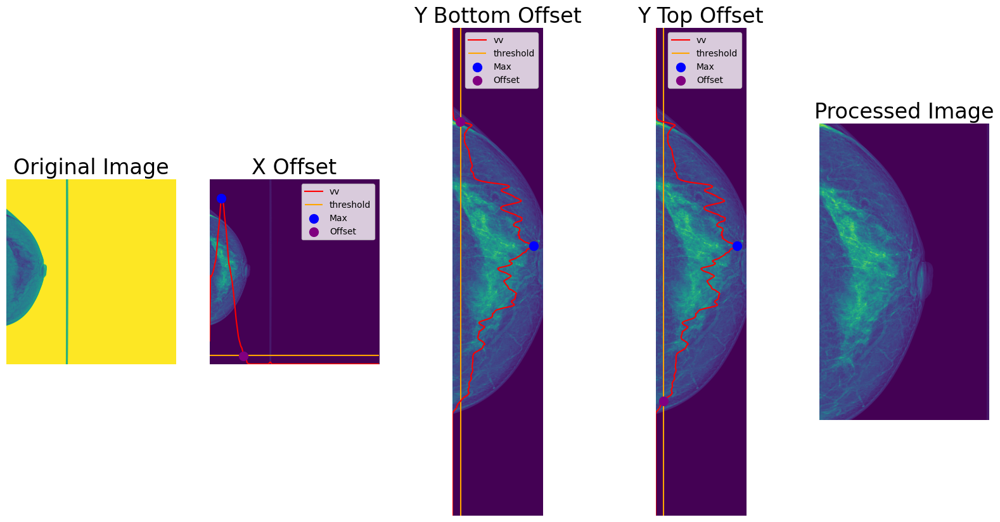

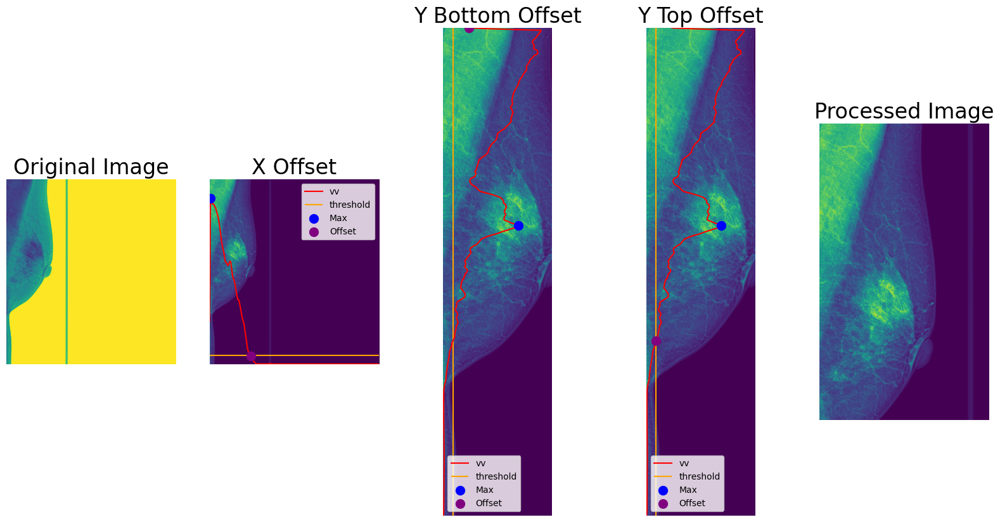

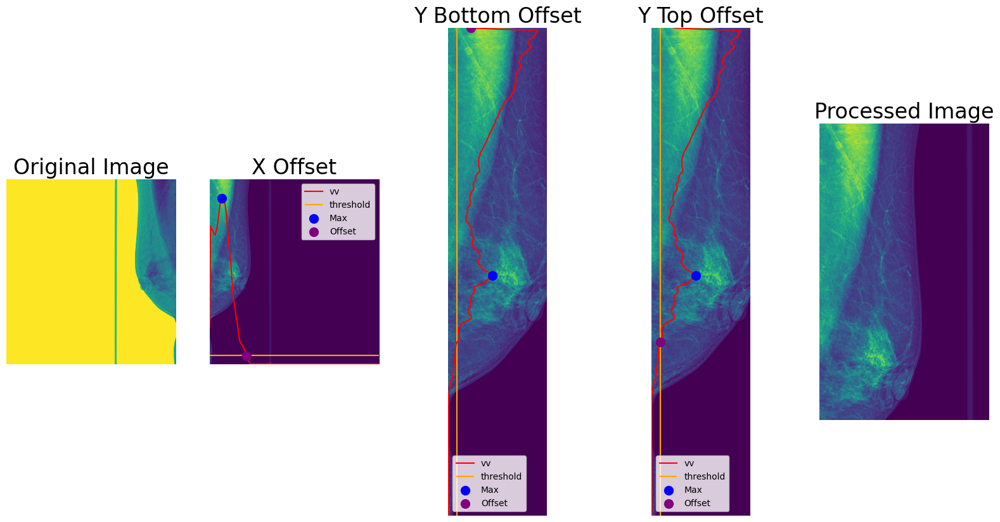

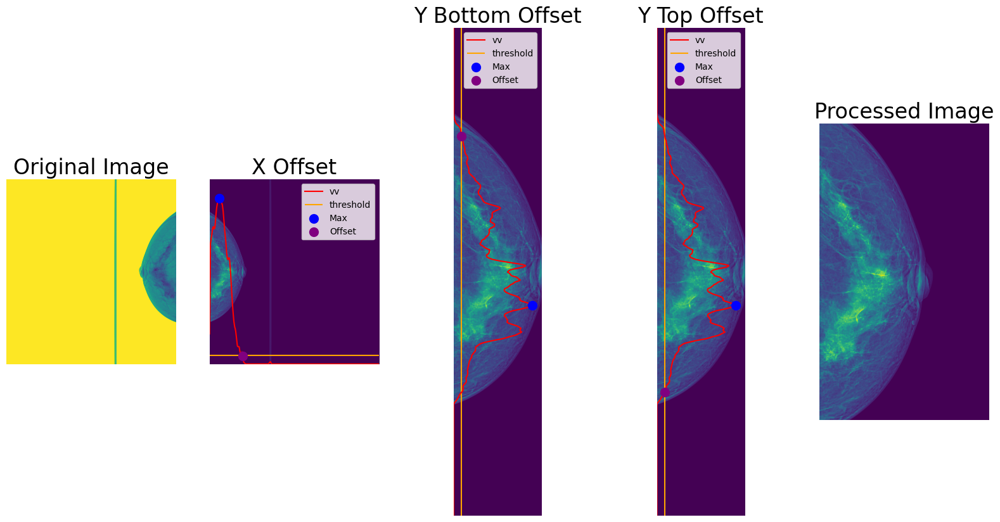

In [53]:
N = 4 if IS_INTERACTIVE else 10
for fp in tqdm(train['file_path'].head(N)):
    process(
            fp,
            crop_image=True,
            size=(TARGET_WIDTH, TARGET_HEIGHT),
            debug=True,
        )

# Example Processed Images

  0%|          | 0/8 [00:00<?, ?it/s]

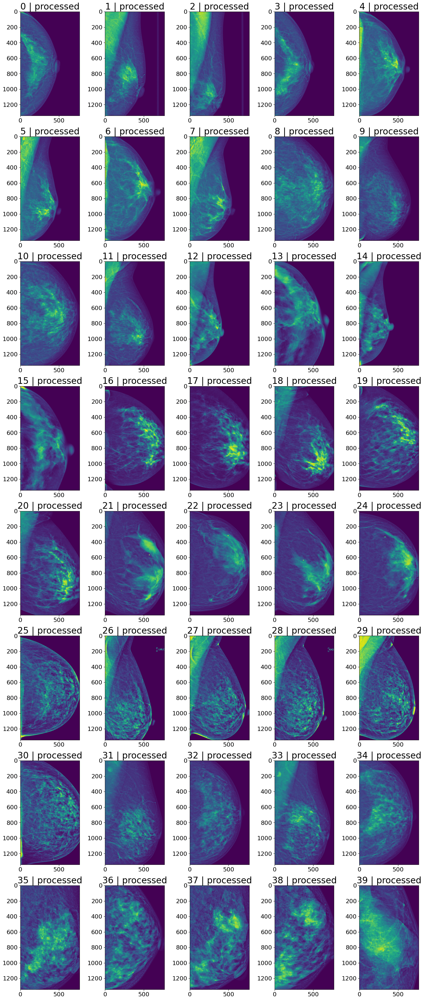

In [54]:
def plot_original_processed_examples(rows=48, cols=5):
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, 6 * rows))
    for r in tqdm(range(rows)):
        for c in range(cols):
            idx = (r * cols) + c
            image = process(
                    train.loc[idx, 'file_path'],
                    crop_image=True,
                    size=(TARGET_WIDTH, TARGET_HEIGHT),
                    apply_clahe=APPLY_CLAHE,
                    apply_eq_hist=APPLY_EQ_HIST,
                    debug=False,
                )
            axes[r, c].imshow(image)
            axes[r, c].set_title(f'{idx} | processed')

    plt.show()
    
plot_original_processed_examples(rows=8 if IS_INTERACTIVE else 32)

# Train

In [55]:
# Check if all patients have both CC and MLO view
if not IS_INTERACTIVE:
    for g_idx, g in tqdm(train.groupby('patient_id')):
        if 'CC' not in g['view'].values or 'MLO' not in g['view'].values:
            display(g)

In [56]:
# Maps a patient_id and image_id to cancer target
PATIENT_ID_IMAGE_ID2CANCER = train.set_index(['patient_id', 'image_id'])['cancer'].to_dict()

# Train Meta Data

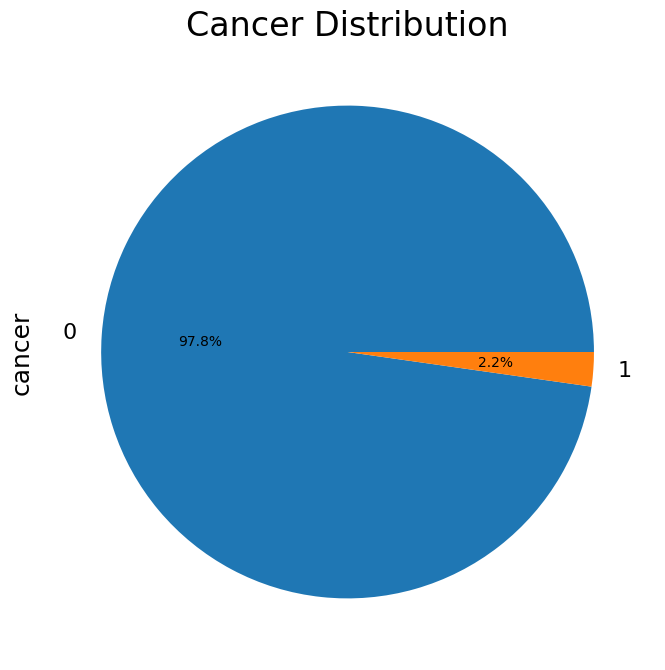

In [57]:
# Train data is imbalanced, we have ~50x more negative samples than positive samples
plt.figure(figsize=(8, 8))
train['cancer'].value_counts().plot(kind='pie', autopct='%1.1f%%', title='Cancer Distribution')
plt.show()

# Image Statistics

In [58]:
# Patient folder paths
FOLDER_PATHS = glob.glob('/kaggle/input/rsna-breast-cancer-detection/train_images/*')
print(f'Found {len(FOLDER_PATHS)} Train Folders')

Found 11913 Train Folders


In [59]:
# File paths
FILE_PATHS = glob.glob('/kaggle/input/rsna-breast-cancer-detection/train_images/*/*.dcm')
print(f'Found {len(FILE_PATHS)} Train Files')

Found 54706 Train Files


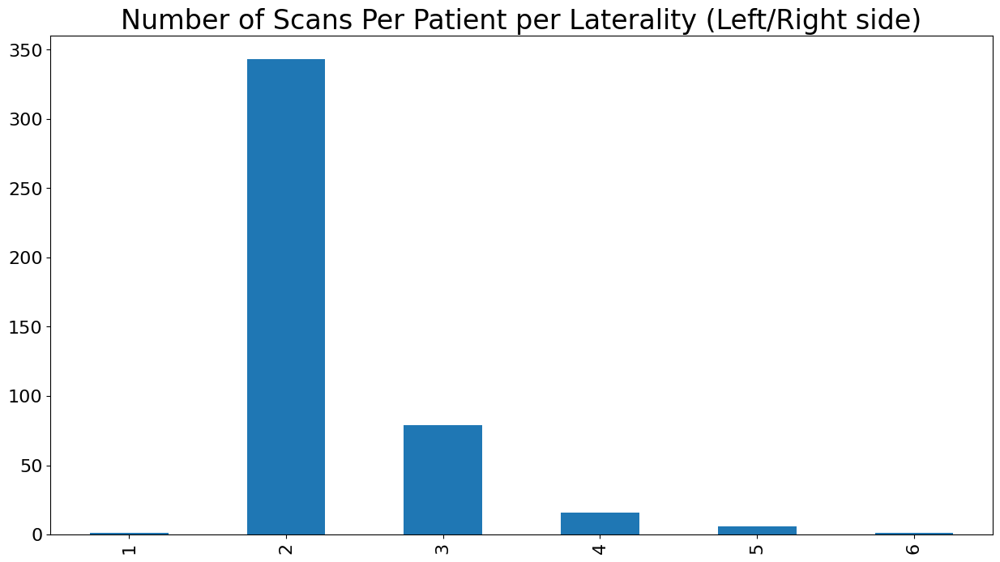

In [60]:
plt.figure(figsize=(15,8))
plt.title('Number of Scans Per Patient per Laterality (Left/Right side)')
train.groupby(['patient_id', 'laterality']).apply(len).value_counts().sort_index().plot(kind='bar')
plt.show()

In [61]:
# View Counts: AT/LM/ML/LMO are rare, too few samples to train on
display(train['view'].value_counts().to_frame('count'))

,count
MLO,528
CC,496


In [62]:
# Scan View Counts: most patient only have a CC and MLO scan
display(train.sort_values('view').groupby(['patient_id', 'laterality'])['view'].apply(tuple).value_counts().to_frame('Count'))

,Count
"(CC, MLO)",343
"(CC, MLO, MLO)",50
"(CC, CC, MLO)",29
"(CC, CC, MLO, MLO)",15
"(CC, CC, MLO, MLO, MLO)",5
"(CC, MLO, MLO, MLO, MLO)",1
"(CC, CC, MLO, MLO, MLO, MLO)",1
"(CC, MLO, MLO, MLO)",1
"(CC,)",1


# Image Dimensions

In [63]:
np.random.seed(42)

# Get height/width statistics
N = int(16 if IS_INTERACTIVE else 1024)
WIDTHS = []
HEIGHTS = []
for fp in tqdm(np.random.choice(FILE_PATHS, N)):
    h, w = process(fp).shape
    HEIGHTS.append(h)
    WIDTHS.append(w)

  0%|          | 0/16 [00:00<?, ?it/s]

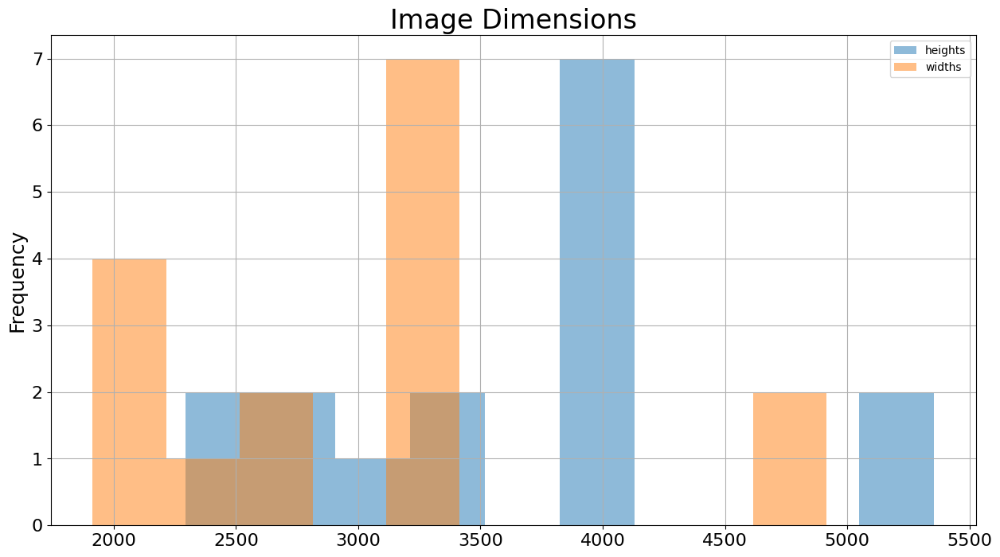

In [64]:
# Patches are insanely huge!
plt.figure(figsize=(15,8))
plt.title('Image Dimensions', size=24)
pd.Series(HEIGHTS).plot(kind='hist', alpha=0.50, label='heights')
pd.Series(WIDTHS).plot(kind='hist', alpha=0.50, label='widths')
plt.grid()
plt.legend()
plt.show()

,Height/Width Ratio's
count,16.000000
mean,1.233575
std,0.070620
min,1.089522
25%,1.222711
50%,1.230769
75%,1.284273
max,1.333333


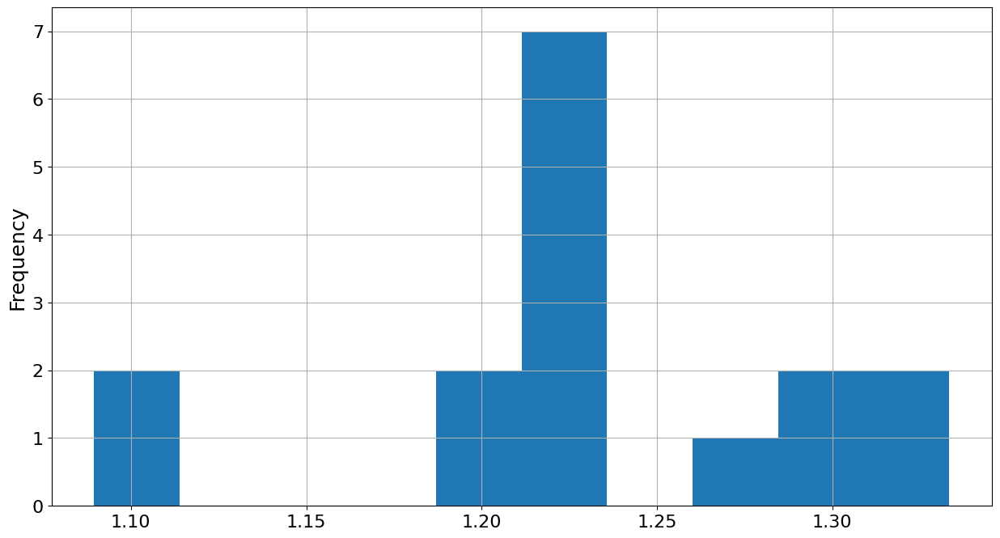

In [65]:
# Height to Width Ratio's, height is roughly 1.25x width, that's why resize to (512*1.25)x512 = 640x512
display(pd.Series(np.array(HEIGHTS) / np.array(WIDTHS)).describe().to_frame('Height/Width Ratio\'s'))

plt.figure(figsize=(15,8))
pd.Series(np.array(HEIGHTS) / np.array(WIDTHS)).plot(kind='hist')
plt.grid()
plt.show()

# Cropped Image Dimensions

In [66]:
np.random.seed(SEED)

N = int(16 if IS_INTERACTIVE else 1024)
WIDTHS_CROPPED = []
HEIGHTS_CROPPED = []

for fp in tqdm(np.random.choice(FILE_PATHS, N)):
    h, w = process(fp, crop_image=True).shape
    WIDTHS_CROPPED.append(h)
    HEIGHTS_CROPPED.append(w)

  0%|          | 0/16 [00:00<?, ?it/s]

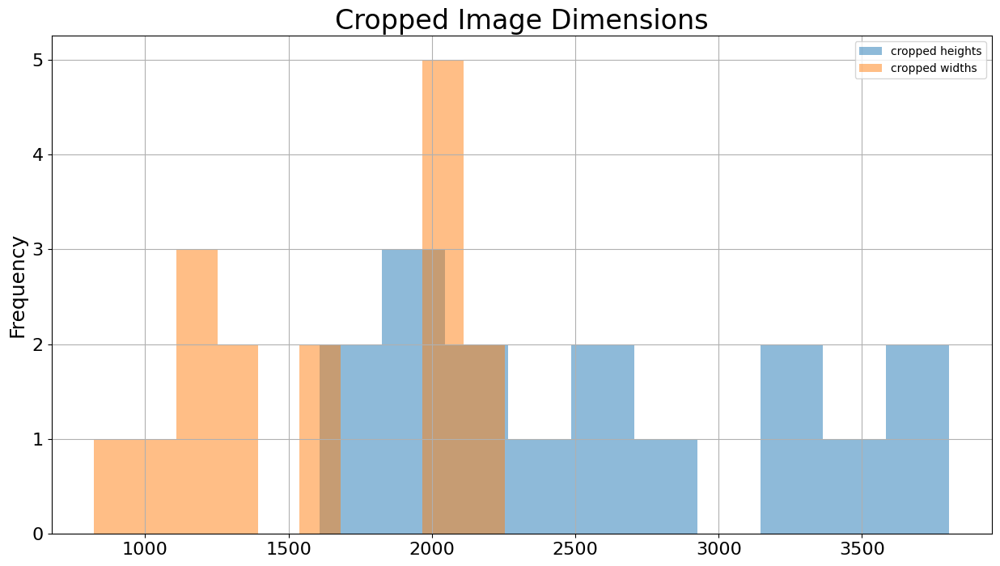

In [67]:
plt.figure(figsize=(15,8))
plt.title('Cropped Image Dimensions', size=24)
pd.Series(WIDTHS_CROPPED).plot(kind='hist', alpha=0.50, label='cropped heights')
pd.Series(HEIGHTS_CROPPED).plot(kind='hist', alpha=0.50, label='cropped widths')
plt.grid()
plt.legend()
plt.show()

,Cropped Height/Width Ratio's
count,16.000000
mean,1.641799
std,0.407492
min,0.930723
25%,1.381796
50%,1.570039
75%,1.825322
max,2.565693


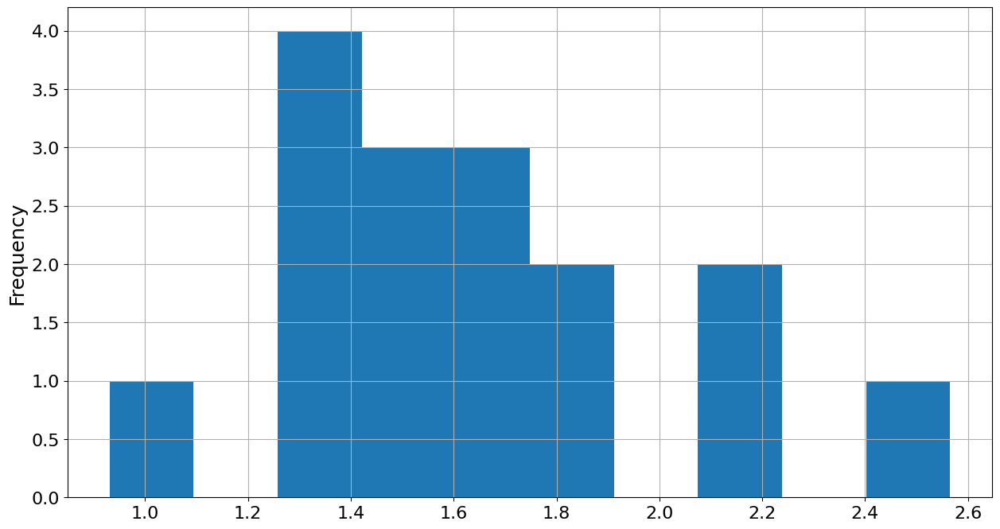

In [68]:
# Height to Width Ratio's
display(pd.Series(np.array(WIDTHS_CROPPED) / np.array(HEIGHTS_CROPPED)).describe().to_frame('Cropped Height/Width Ratio\'s'))
plt.figure(figsize=(15,8))
pd.Series(np.array(WIDTHS_CROPPED) / np.array(HEIGHTS_CROPPED)).plot(kind='hist')
plt.grid()
plt.show()

# Chunk Generation

In [69]:
# Make Pairs of Views as input to the model
FILE_PATHS_PAIRS = []
for row_idx, row in tqdm(train.iterrows(), total=len(train)):
        FILE_PATHS_PAIRS.append(row[['patient_id', 'image_id']].values)
        
FILE_PATHS_PAIRS = np.array(FILE_PATHS_PAIRS, dtype=object)
print(f'FILE_PATHS_PAIRS shape: {FILE_PATHS_PAIRS.shape}')

  0%|          | 0/1024 [00:00<?, ?it/s]

FILE_PATHS_PAIRS shape: (1024, 2)


In [70]:
# Put every image in a seperate TFRecord file
N_CHUNKS = 100
CHUNKS = np.array_split(FILE_PATHS_PAIRS, N_CHUNKS)

print(f'N_CHUNKS: {N_CHUNKS}, CHUNK len: {len(CHUNKS[0])}, shape: {CHUNKS[0].shape}')

N_CHUNKS: 100, CHUNK len: 11, shape: (11, 2)


In [71]:
# Single sample processing
def process_chunk(args):
    patient_id, image_id = args
    # Define file path
    fp = f'/kaggle/input/rsna-breast-cancer-detection/train_images/{patient_id}/{image_id}.dcm'
    # Get processed image and target
    image, target = process(fp, size=(TARGET_WIDTH, TARGET_HEIGHT), ret_target=True, crop_image=True)

    # Make grayscale channel
    image = np.expand_dims(image, 2)
    
    # Encode PNG
    if IMAGE_FORMAT == 'PNG':
        image_serialized = tf.io.encode_png(image, compression=9).numpy()
    # Encode JPEG
    else:
        image_serialized = tf.io.encode_jpeg(image, quality=IMAGE_QUALITY, optimize_size=True).numpy()
    
    return image_serialized, target, patient_id, image_id

In [72]:
def to_tf_records(chunks):
    for chunk_idx, chunk in enumerate(tqdm(chunks)):
        print(f'===== GENERATING TFRECORDS {chunk_idx} =====')
        tfrecord_name = f'batch_{chunk_idx}.tfrecords'
        
        # Create the actual TFRecords
        options = tf.io.TFRecordOptions(compression_type='GZIP', compression_level=9)
        with tf.io.TFRecordWriter(tfrecord_name, options=options) as file_writer:
            # Process Samples in Chunk in Parallell
            jobs = [joblib.delayed(process_chunk)(args) for args in chunk]
            chunk_processed = joblib.Parallel(
                n_jobs=cpu_count(),
                verbose=0,
                backend='multiprocessing',
                prefer='threads',
            )(jobs)
            
            # Add Processed Samples to TFRecord
            for image, target, patient_id, image_id in chunk_processed:
                record_bytes = tf.train.Example(features=tf.train.Features(feature={
                    # Image
                    'image': tf.train.Feature(bytes_list=tf.train.BytesList(value=[image])),

                    # target
                    'target': tf.train.Feature(int64_list=tf.train.Int64List(value=[target])),
                    
                    # patient_id
                    'patient_id': tf.train.Feature(int64_list=tf.train.Int64List(value=[patient_id])),
                    
                    # image_id
                    'image_id': tf.train.Feature(int64_list=tf.train.Int64List(value=[image_id])),
                })).SerializeToString()
                file_writer.write(record_bytes)
            
# Create TFRecords
if IS_INTERACTIVE:
    to_tf_records(CHUNKS[:10])
else:
    to_tf_records(CHUNKS)

  0%|          | 0/10 [00:00<?, ?it/s]

===== GENERATING TFRECORDS 0 =====


2023-02-22 05:11:12.817251: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:11:12.823316: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:11:12.823978: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:11:12.824463: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:11:12.828726: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 1 =====


2023-02-22 05:11:17.872894: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:11:17.874965: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:11:17.875280: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:11:17.875582: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:11:17.877379: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 2 =====


2023-02-22 05:11:22.169525: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:11:22.171504: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:11:22.171709: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:11:22.171822: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:11:22.173775: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 3 =====


2023-02-22 05:11:30.412594: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:11:30.415056: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:11:30.415172: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:11:30.415251: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:11:30.417942: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 4 =====


2023-02-22 05:11:36.873640: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:11:36.875795: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:11:36.876045: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:11:36.876143: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:11:36.878112: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 5 =====


2023-02-22 05:11:41.220886: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:11:41.231950: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:11:41.232530: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:11:41.233324: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:11:41.235711: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 6 =====


2023-02-22 05:11:46.473075: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:11:46.475170: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:11:46.475518: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:11:46.475859: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:11:46.477692: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 7 =====


2023-02-22 05:11:57.710352: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:11:57.712877: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:11:57.713107: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:11:57.713217: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:11:57.715048: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 8 =====


2023-02-22 05:12:03.436244: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:12:03.439074: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:12:03.439535: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:12:03.439924: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:12:03.441806: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

===== GENERATING TFRECORDS 9 =====


2023-02-22 05:12:08.495855: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:12:08.498954: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:12:08.499383: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:12:08.499768: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:12:08.501574: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

# Check TFRecords

In [73]:
N = 16 if IS_INTERACTIVE else 32

In [74]:
# Function to decode the TFRecords
def decode_tfrecord(record_bytes):
    features = tf.io.parse_single_example(record_bytes, {
        'image': tf.io.FixedLenFeature([], tf.string),
        'target': tf.io.FixedLenFeature([], tf.int64),
        'patient_id': tf.io.FixedLenFeature([], tf.int64),
        'image_id': tf.io.FixedLenFeature([], tf.int64),
    })
        
    if IMAGE_FORMAT == 'PNG':
        image = tf.io.decode_png(features['image'], channels=N_CHANNELS)
    else:
        image = tf.io.decode_jpeg(features['image'], channels=N_CHANNELS)
        
    image = tf.reshape(image, [TARGET_HEIGHT, TARGET_WIDTH, N_CHANNELS])

    target = features['target']
    patient_id = features['patient_id']
    image_id = features['image_id']
    
    return image, target, patient_id, image_id

In [75]:
# Sample TFRecord Dataset
def get_train_dataset():
    # Read all TFRecord file paths
    FNAMES_TRAIN_TFRECORDS = tf.io.gfile.glob('./*.tfrecords')
    # initialize TFRecord dataset
    train_dataset = tf.data.TFRecordDataset(FNAMES_TRAIN_TFRECORDS, num_parallel_reads=1, compression_type='GZIP')
    # Decode samples by mapping with decode function
    train_dataset = train_dataset.map(decode_tfrecord)
    # Batch samples
    train_dataset = train_dataset.batch(N)
    
    return train_dataset

In [76]:
# Shows a batch of images
def show_batch(dataset, rows=N, cols=1):
    images, targets, patient_ids, image_ids = next(iter(dataset))
    images = np.moveaxis(images, 3, 1)
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(cols*6, rows*10))
    for r in range(rows):
        for c in range(cols):
            img = images[r,c]
            axes[r].imshow(img)
            if c == 0:
                target = targets[r]
                patient_id = patient_ids[r]
                image_id = image_ids[r]
                axes[r].set_title(f'target: {target}, patient_id: {patient_id}, image_id: {image_id}', fontsize=12, pad=16)
        
    plt.show()

2023-02-22 05:12:13.022832: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:12:13.023357: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2023-02-22 05:12:13.023412: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-22 05:12:13.023453: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ed870f5e5b8b): /proc/driver/nvidia/version does not exist
2023-02-22 05:12:13.024222: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operation

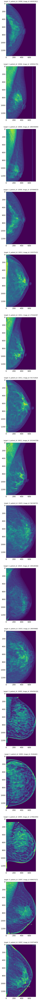

In [77]:
# Show Example Batch
train_dataset = get_train_dataset()
show_batch(train_dataset)

# Training

In [78]:
#Install ConvNextV2 Models From Keras CV Attention Models Pip Package
!pip install -qq /kaggle/input/keras-cv-attention-models/keras_cv_attention_models-1.3.5-py3-none-any.whl

In [79]:
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow_addons as tfa
import matplotlib.pyplot as plt
import matplotlib as mpl

from tqdm.notebook import tqdm
from multiprocessing import cpu_count
from kaggle_datasets import KaggleDatasets
from sklearn.model_selection import train_test_split
from keras_cv_attention_models import convnext

import os
import time
import pickle
import math
import random
import sys
import cv2
import gc
import datetime

print(f'Tensorflow Version: {tf.__version__}')
print(f'Python Version: {sys.version}')

Tensorflow Version: 2.4.1
Python Version: 3.7.10 | packaged by conda-forge | (default, Feb 19 2021, 16:07:37) 
[GCC 9.3.0]


# Save Versions

In [80]:
now = datetime.datetime.now().strftime("%d-%b-%Y %H-%M-%S")
np.save(now, np.array([now]))

# Mixed Precision Policy

In [81]:
# float32 or mixed_float16 (mixed precision: compute float16, variable float32)
# TPU is fast enough and has enough memory to use float32
policy = tf.keras.mixed_precision.Policy('float32')
tf.keras.mixed_precision.set_global_policy(policy)

print(f'Compute dtype: {tf.keras.mixed_precision.global_policy().compute_dtype}')
print(f'Variable dtype: {tf.keras.mixed_precision.global_policy().variable_dtype}')

Compute dtype: float32
Variable dtype: float32


# Matplotlib Config

In [82]:
# MatplotLib Global Settings
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.rcParams['xtick.labelsize'] = 16
mpl.rcParams['ytick.labelsize'] = 16
mpl.rcParams['axes.labelsize'] = 18
mpl.rcParams['axes.titlesize'] = 24

# Config

In [83]:
# Detect hardware, return appropriate distribution strategy
try:
    TPU = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection. No parameters necessary if TPU_NAME environment variable is set. On Kaggle this is always the case.
    print('Running on TPU ', TPU.master())
except ValueError:
    print('Running on GPU')
    TPU = None

if TPU:
    IS_TPU = True
    tf.config.experimental_connect_to_cluster(TPU)
    tf.tpu.experimental.initialize_tpu_system(TPU)
    STRATEGY = tf.distribute.experimental.TPUStrategy(TPU)
else:
    IS_TPU = False
    STRATEGY = tf.distribute.get_strategy() # default distribution strategy in Tensorflow. Works on CPU and single GPU.

N_REPLICAS = STRATEGY.num_replicas_in_sync
print(f'N_REPLICAS: {N_REPLICAS}, IS_TPU: {IS_TPU}')

Running on TPU  grpc://10.0.0.2:8470


2023-02-22 05:12:29.463432: I tensorflow/compiler/jit/xla_gpu_device.cc:99] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-02-22 05:12:29.489641: I tensorflow/core/distributed_runtime/rpc/grpc_channel.cc:301] Initialize GrpcChannelCache for job worker -> {0 -> 10.0.0.2:8470}
2023-02-22 05:12:29.489704: I tensorflow/core/distributed_runtime/rpc/grpc_channel.cc:301] Initialize GrpcChannelCache for job localhost -> {0 -> localhost:30021}
2023-02-22 05:12:29.496302: I tensorflow/core/distributed_runtime/rpc/grpc_channel.cc:301] Initialize GrpcChannelCache for job worker -> {0 -> 10.0.0.2:8470}
2023-02-22 05:12:29.496374: I tensorflow/core/distributed_runtime/rpc/grpc_channel.cc:301] Initialize GrpcChannelCache for job localhost -> {0 -> localhost:30021}
2023-02-22 05:12:29.497386: I tensorflow/core/distributed_runtime/rpc/grpc_server_lib.cc:411] Started server with target: grpc://localhost:30021


N_REPLICAS: 8, IS_TPU: True


In [84]:
# For TPU's the dataset needs to be stored in Google Cloud
# Retrieve the Google Cloud location of the dataset
GCS_DS_PATH = KaggleDatasets().get_gcs_path('rsna-preprocessing-tfrecords-640x512-dataset-pub')

In [85]:
SEED = 43
DEBUG = False

# Image dimensions
IMG_HEIGHT = 1344
IMG_WIDTH = 768
N_CHANNELS = 1
INPUT_SHAPE = (IMG_HEIGHT, IMG_WIDTH, 1)
N_SAMPLES_TFRECORDS = 548

# Peak Learning Rate
LR_MAX = 5e-6 * N_REPLICAS
WD_RATIO = 0.01

N_WARMUP_EPOCHS = 0
N_EPOCHS = 10

# Batch size
BATCH_SIZE = 8 * N_REPLICAS

# Is Interactive Flag and COrresponding Verbosity Method
IS_INTERACTIVE = os.environ['KAGGLE_KERNEL_RUN_TYPE'] == 'Interactive'
VERBOSE = 1 if IS_INTERACTIVE else 2

# Tensorflow AUTO flag
AUTO = tf.data.experimental.AUTOTUNE

print(f'BATCH_SIZE: {BATCH_SIZE}')

BATCH_SIZE: 64


# Seed

In [86]:
# Seed all random number generators
def seed_everything(seed=SEED):
    os.environ['PYTHONHASHSEED'] = str(seed)
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)

seed_everything()

# Train

In [87]:
# Train DataFrame
train = pd.read_csv('/kaggle/input/rsna-breast-cancer-detection/train.csv')

display(train.head())
display(train.info())

,site_id,patient_id,image_id,laterality,view,age,cancer,biopsy,invasive,BIRADS,implant,density,machine_id,difficult_negative_case
0,2,10006,462822612,L,CC,61.0,0,0,0,NaN,0,NaN,29,False
1,2,10006,1459541791,L,MLO,61.0,0,0,0,NaN,0,NaN,29,False
2,2,10006,1864590858,R,MLO,61.0,0,0,0,NaN,0,NaN,29,False
3,2,10006,1874946579,R,CC,61.0,0,0,0,NaN,0,NaN,29,False
4,2,10011,220375232,L,CC,55.0,0,0,0,0.0,0,NaN,21,True


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54706 entries, 0 to 54705
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   site_id                  54706 non-null  int64  
 1   patient_id               54706 non-null  int64  
 2   image_id                 54706 non-null  int64  
 3   laterality               54706 non-null  object 
 4   view                     54706 non-null  object 
 5   age                      54669 non-null  float64
 6   cancer                   54706 non-null  int64  
 7   biopsy                   54706 non-null  int64  
 8   invasive                 54706 non-null  int64  
 9   BIRADS                   26286 non-null  float64
 10  implant                  54706 non-null  int64  
 11  density                  29470 non-null  object 
 12  machine_id               54706 non-null  int64  
 13  difficult_negative_case  54706 non-null  bool   
dtypes: bool(1), float64(2)

None

# Utility Functions

In [88]:
# short Tensorflow randin integer function
def tf_rand_int(minval, maxval, dtype=tf.int64):
    minval = tf.cast(minval, dtype)
    maxval = tf.cast(maxval, dtype)
    return tf.random.uniform(shape=(), minval=minval, maxval=maxval, dtype=dtype)

# chance of 1 in k
def one_in(k):
    return 0 == tf_rand_int(0, k)

# Dataset

In [89]:
# Function to benchmark the dataset
def benchmark_dataset(dataset, num_epochs=3, n_steps_per_epoch=10, bs=BATCH_SIZE):
    start_time = time.perf_counter()
    for epoch_num in range(num_epochs):
        for idx, (inputs, labels) in enumerate(dataset.take(n_steps_per_epoch + 1)):
            if idx == 0:
                epoch_start = time.perf_counter()
            elif idx == 1 and epoch_num == 0:
                image = inputs['image']
                print(f'image shape: {image.shape}, labels shape: {labels.shape}, image dtype: {image.dtype}, labels dtype: {labels.dtype}')
            else:
                pass
        
        epoch_t = time.perf_counter() - epoch_start
        mean_step_t = round(epoch_t / n_steps_per_epoch * 1000, 1)
        n_imgs_per_s = int(1 / (mean_step_t / 1000) * bs)
        print(f'epoch {epoch_num} took: {round(epoch_t, 2)} sec, mean step duration: {mean_step_t}ms, images/s: {n_imgs_per_s}')

In [90]:
# Plots a batch of images
def show_batch(dataset, n_rows=16, n_cols=4):
    inputs, targets = next(iter(dataset))
    images = inputs['image'].numpy().squeeze()
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(n_cols*4, n_rows*7))
    for r in range(n_rows):
        for c in range(n_cols):
            idx = r * n_cols + c
            # Image
            img = images[idx]
            axes[r, c].imshow(img)
            # Target
            target = targets[idx]
            axes[r, c].set_title(f'target: {target}', fontsize=16, pad=5)
        
    plt.show()

In [91]:
# Decodes the TFRecords
def decode_image(record_bytes):
    features = tf.io.parse_single_example(record_bytes, {
        'image': tf.io.FixedLenFeature([], tf.string),
        'target': tf.io.FixedLenFeature([], tf.int64),
        'patient_id': tf.io.FixedLenFeature([], tf.int64),
    })
    
    # Decode PNG Image
    image = tf.io.decode_jpeg(features['image'], channels=N_CHANNELS)
    # Explicit reshape needed for TPU
    image = tf.reshape(image, [IMG_HEIGHT, IMG_WIDTH, N_CHANNELS])

    target = features['target']
    
    return { 'image': image }, target

In [92]:
def augment_image(X, y):
    image = X['image']
    
    # Random Brightness
    image = tf.image.random_brightness(image, 0.10)
    
    # Random Contrast
    image = tf.image.random_contrast(image, 0.90, 1.10)
    
    # Random JPEG Quality
    image = tf.image.random_jpeg_quality(image, 75, 100)
    
    # Random crop image with maximum of 10%
    ratio = tf.random.uniform([], 0.75, 1.00)
    img_height_crop = tf.cast(ratio * IMG_HEIGHT, tf.int32)
    img_width_crop = tf.cast(ratio * IMG_WIDTH, tf.int32)
    # Random offset for crop
    img_height_offset = tf_rand_int(0, IMG_HEIGHT - img_height_crop)
    img_width_offset = 0
    # Crop And Resize
    image = tf.slice(image, [img_height_offset, img_width_offset, 0], [img_height_crop, img_width_crop, N_CHANNELS])
    image = tf.image.resize(image, [IMG_HEIGHT, IMG_WIDTH], method=tf.image.ResizeMethod.BILINEAR)
    # Clip pixel values in range [0,255] to prevent underflow/overflow
    image = tf.clip_by_value(image, 0, 255)
    image = tf.cast(image, tf.uint8)
    
    return { 'image': image }, y

In [93]:
# Undersample majority class (0/negative) by randomly dropping them
def undersample_majority(X, y):
    # Filter 2/3 of negative samples to upsample positive samples by a factor 3
    return y == 1 or tf.random.uniform([]) > 0.66

In [94]:
# TFRecord file paths
TFRECORDS_FILE_PATHS = sorted(tf.io.gfile.glob(f'{GCS_DS_PATH}/*.tfrecords'))
print(f'Found {len(TFRECORDS_FILE_PATHS)} TFRecords')

Found 100 TFRecords


2023-02-22 05:12:35.499333: I tensorflow/core/platform/cloud/google_auth_provider.cc:180] Attempting an empty bearer token since no token was retrieved from files, and GCE metadata check was skipped.


In [95]:
# Train Test Split
TFRECORDS_TRAIN, TFRECORDS_VAL = train_test_split(TFRECORDS_FILE_PATHS, train_size=0.80, random_state=SEED, shuffle=True)
print(f'# TFRECORDS_TRAIN: {len(TFRECORDS_TRAIN)}, # TFRECORDS_VAL: {len(TFRECORDS_VAL)}')

# TFRECORDS_TRAIN: 80, # TFRECORDS_VAL: 20


In [96]:
def get_dataset(tfrecords, bs=BATCH_SIZE, val=False, debug=True):
    ignore_order = tf.data.Options()
    ignore_order.experimental_deterministic = False
    
    # Initialize dataset with TFRecords
    dataset = tf.data.TFRecordDataset(tfrecords, num_parallel_reads=AUTO, compression_type='GZIP')
    
    # Decode mapping
    dataset = dataset.map(decode_image, num_parallel_calls=AUTO)

    if not val:
        dataset = dataset.filter(undersample_majority)
        dataset = dataset.map(augment_image, num_parallel_calls=AUTO)
        dataset = dataset.with_options(ignore_order)
        if not debug:
            dataset = dataset.shuffle(1024)
        dataset = dataset.repeat()        

    dataset = dataset.batch(bs, drop_remainder=not val)
    dataset = dataset.prefetch(AUTO)
    
    return dataset

In [97]:
# Get Train/Validation datasets
train_dataset = get_dataset(TFRECORDS_TRAIN, val=False, debug=False)
val_dataset = get_dataset(TFRECORDS_VAL, val=True, debug=False)

TRAIN_STEPS_PER_EPOCH = len(TFRECORDS_TRAIN) * N_SAMPLES_TFRECORDS // BATCH_SIZE
VAL_STEPS_PER_EPOCH = len(TFRECORDS_VAL) * N_SAMPLES_TFRECORDS // BATCH_SIZE
print(f'TRAIN_STEPS_PER_EPOCH: {TRAIN_STEPS_PER_EPOCH}, VAL_STEPS_PER_EPOCH: {VAL_STEPS_PER_EPOCH}')

TRAIN_STEPS_PER_EPOCH: 685, VAL_STEPS_PER_EPOCH: 171


In [98]:
# Sanity check, image and label statistics
X_batch, y_batch = next(iter(get_dataset(TFRECORDS_TRAIN, val=False)))
image = X_batch['image'].numpy()
print(f'image shape: {image.shape}, y_batch shape: {y_batch.shape}')
print(f'image dtype: {image.dtype}, y_batch dtype: {y_batch.dtype}')
print(f'image min: {image.min():.2f}, max: {image.max():.2f}')

image shape: (64, 1344, 768, 1), y_batch shape: (64,)
image dtype: uint8, y_batch dtype: <dtype: 'int64'>
image min: 0.00, max: 255.00


In [99]:
# Benchmark Dataset
benchmark_dataset(get_dataset(TFRECORDS_TRAIN, val=False))

image shape: (64, 1344, 768, 1), labels shape: (64,), image dtype: <dtype: 'uint8'>, labels dtype: <dtype: 'int64'>
epoch 0 took: 19.56 sec, mean step duration: 1955.5ms, images/s: 32


2023-02-22 05:13:03.344441: W ./tensorflow/core/distributed_runtime/eager/destroy_tensor_handle_node.h:57] Ignoring an error encountered when deleting remote tensors handles: Invalid argument: Unable to find the relevant tensor remote_handle: Op ID: 97, Output num: 0
Additional GRPC error information from remote target /job:worker/replica:0/task:0:
:{"created":"@1677042783.340994496","description":"Error received from peer ipv4:10.0.0.2:8470","file":"external/com_github_grpc_grpc/src/core/lib/surface/call.cc","file_line":1056,"grpc_message":"Unable to find the relevant tensor remote_handle: Op ID: 97, Output num: 0","grpc_status":3}


epoch 1 took: 19.71 sec, mean step duration: 1971.5ms, images/s: 32
epoch 2 took: 19.51 sec, mean step duration: 1951.2ms, images/s: 32


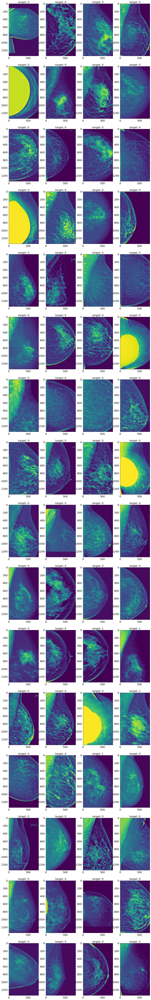

In [100]:
# Show what we will be training on
show_batch(get_dataset(TFRECORDS_TRAIN, bs=64, val=False))

# Class Imbalance

In [101]:
# Label Distribution Train With Undersampled Majority Class
N = 128
train_labels = []
for _, labels in tqdm(get_dataset(TFRECORDS_TRAIN, val=False).take(N), total=N):
    train_labels += labels.numpy().tolist()
    
display(pd.concat((
        pd.Series(train_labels).value_counts(normalize=True).to_frame('Train Label Ratio'),
        pd.Series(train_labels).value_counts().to_frame('Train Label Count'),
    ), axis=1)
)

  0%|          | 0/128 [00:00<?, ?it/s]

2023-02-22 05:17:59.477620: W ./tensorflow/core/distributed_runtime/eager/destroy_tensor_handle_node.h:57] Ignoring an error encountered when deleting remote tensors handles: Invalid argument: Unable to find the relevant tensor remote_handle: Op ID: 762, Output num: 0
Additional GRPC error information from remote target /job:worker/replica:0/task:0:
:{"created":"@1677043079.477465812","description":"Error received from peer ipv4:10.0.0.2:8470","file":"external/com_github_grpc_grpc/src/core/lib/surface/call.cc","file_line":1056,"grpc_message":"Unable to find the relevant tensor remote_handle: Op ID: 762, Output num: 0","grpc_status":3}


,Train Label Ratio,Train Label Count
0,0.935913,7667
1,0.064087,525


In [102]:
# Label Distribution Validation (Unchanged)
val_labels = []
for _, labels in tqdm(get_dataset(TFRECORDS_VAL, val=True), total=VAL_STEPS_PER_EPOCH):
    val_labels += labels.numpy().tolist()
    
display(pd.concat((
        pd.Series(val_labels).value_counts(normalize=True).to_frame('Val Label Ratio'),
        pd.Series(val_labels).value_counts().to_frame('Val Label Count'),
    ), axis=1)
)

  0%|          | 0/171 [00:00<?, ?it/s]

,Val Label Ratio,Val Label Count
0,0.979163,10714
1,0.020837,228


# pF1 Metric

In [103]:
# Tensorflow custom metric is just a conventional class object
class pF1(tf.keras.metrics.Metric):
    # Initialize properties
    def __init__(self, name='pF1', **kwargs):
        super(pF1, self).__init__(name=name, **kwargs)
        self.tc = self.add_weight(name='tc', initializer='zeros')
        self.tp = self.add_weight(name='tp', initializer='zeros')
        self.fp = self.add_weight(name='fp', initializer='zeros')

    # Update state called on each batch with true and predicted labels
    def update_state(self, y_true, y_pred, sample_weight=None):
        self.tc.assign_add(tf.cast(tf.reduce_sum(y_true), tf.float32))
        self.tp.assign_add(tf.cast(tf.reduce_sum((y_pred[y_true == 1])), tf.float32))
        self.fp.assign_add(tf.cast(tf.reduce_sum((y_pred[y_true == 0])), tf.float32))

    # Result function is called to obtain result which is printed in progress bar
    def result(self):
        if self.tc == 0 or (self.tp + self.fp) == 0:
            return 0.0
        else:
            precision = self.tp / (self.tp + self.fp)
            recall = self.tp / (self.tc)
            return 2 * (precision * recall) / (precision + recall)

    # Reset state is called after each epoch to start fresh each epoch
    def reset_state(self):
        self.tc.assign(0)
        self.tp.assign(0)
        self.fp.assign(0)

# Model

In [104]:
def normalize(image):
    # Repeat channels to create 3 channel images required by pretrained ConvNextV2 models
    image = tf.repeat(image, repeats=3, axis=3)
    # Cast to float 32
    image = tf.cast(image, tf.float32)
    # Normalize with respect to ImageNet mean/std
    image = tf.keras.applications.imagenet_utils.preprocess_input(image, mode='torch')

    return image

In [105]:
def get_model():
    # Verify Mixed Policy Settings
    print(f'Compute dtype: {tf.keras.mixed_precision.global_policy().compute_dtype}')
    print(f'Variable dtype: {tf.keras.mixed_precision.global_policy().variable_dtype}')
    
    with STRATEGY.scope():
        # Set seed for deterministic weights initialization
        seed_everything()
        
        # Inputs, note the names are equal to the dictionary keys in the dataset
        image = tf.keras.layers.Input(INPUT_SHAPE, name='image', dtype=tf.uint8)
        
        # Normalize Input
        image_norm = normalize(image)
        
        # Normalize Input
        image_norm = normalize(image)

        # CNN Prediction in range [0,1]
        x = convnext.ConvNeXtV2Tiny(
            input_shape=(IMG_HEIGHT, IMG_WIDTH, 3),
            pretrained='imagenet21k-ft1k',
            num_classes=0,
        )(image_norm)
        
        # Average Pooling BxHxWxC -> BxC
        x = tf.keras.layers.GlobalAveragePooling2D()(x)
        # Dropout to prevent Overfitting
        x = tf.keras.layers.Dropout(0.30)(x)
        # Output value between [0, 1] using Sigmoid function
        outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)

        # We will use the famous AdamW optimizer for fast learning with weight decay
        optimizer = tfa.optimizers.AdamW(learning_rate=LR_MAX, weight_decay=LR_MAX*WD_RATIO, epsilon=1e-6)

        # Loss
        loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)
        
        # Metrics
        metrics = [
            pF1(),
            tfa.metrics.F1Score(num_classes=1, threshold=0.50),
            tf.keras.metrics.Precision(),
            tf.keras.metrics.Recall(),
            tf.keras.metrics.AUC(),
            tf.keras.metrics.BinaryAccuracy(),
        ]

        model = tf.keras.models.Model(inputs=image, outputs=outputs)
        
        model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

        return model

In [106]:
# Pretrained File Path: '/kaggle/input/sartorius-training-dataset/model.h5'
tf.keras.backend.clear_session()
# enable XLA optmizations
tf.config.optimizer.set_jit(True)

model = get_model()

Compute dtype: float32
Variable dtype: float32
115146752/115145456 [==============================] - 2s 0us/step
>>>> Load pretrained from: /root/.keras/models/convnext_v2_tiny_384_imagenet21k-ft1k.h5


In [107]:
# Plot model summary
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
image (InputLayer)           [(None, 1344, 768, 1)]    0         
_________________________________________________________________
tf.repeat_1 (TFOpLambda)     (None, 1344, 768, None)   0         
_________________________________________________________________
tf.cast_1 (TFOpLambda)       (None, 1344, 768, None)   0         
_________________________________________________________________
tf.math.truediv_2 (TFOpLambd (None, 1344, 768, None)   0         
_________________________________________________________________
tf.nn.bias_add_1 (TFOpLambda (None, 1344, 768, 3)      0         
_________________________________________________________________
tf.math.truediv_3 (TFOpLambd (None, 1344, 768, 3)      0         
_________________________________________________________________
convnext_v2_tiny (Functional (None, 42, 24, 768)       278649

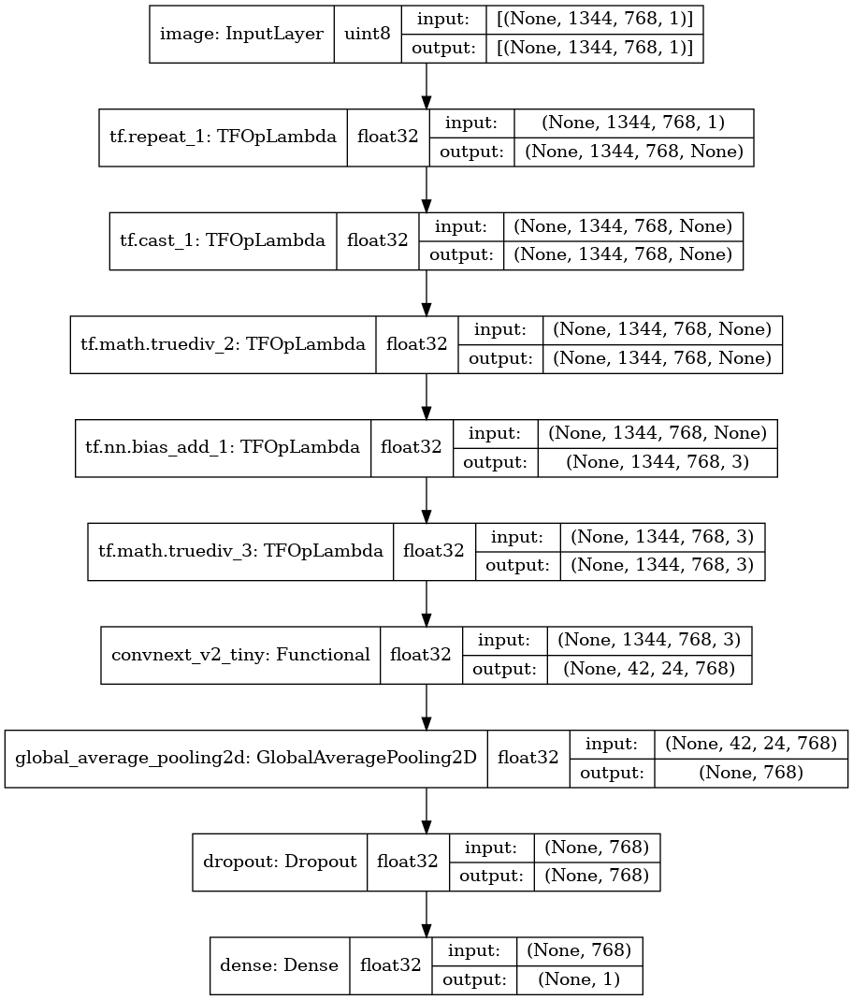

In [108]:
# Model architecture
tf.keras.utils.plot_model(model, show_shapes=True, show_dtype=True, show_layer_names=True, expand_nested=False)

# Weight Initilization

In [109]:
# Validation metric on initialized model
_ = model.evaluate(
        get_dataset(TFRECORDS_VAL, val=True),
        verbose=VERBOSE,
        steps=VAL_STEPS_PER_EPOCH,
    )

171/171 [==============================] - 85s 359ms/step - loss: 0.5102 - pF1: 0.0394 - f1_score: 0.0273 - precision: 0.0150 - recall: 0.1540 - auc: 0.4795 - binary_accuracy: 0.7671


In [110]:
# Train Output Baseline
train_preds = model.predict(
        get_dataset(TFRECORDS_TRAIN, val=True),
        verbose=VERBOSE,
        steps=128,
    ).squeeze()

128/128 [==============================] - 238s 2s/step


In [111]:
# Initialized model train predictions: should not be saturated (all 0/1)
display(pd.Series(train_preds).describe().to_frame('Value').round(2))

,Value
count,8192.00
mean,0.37
std,0.17
min,0.01
25%,0.24
50%,0.37
75%,0.48
max,0.93


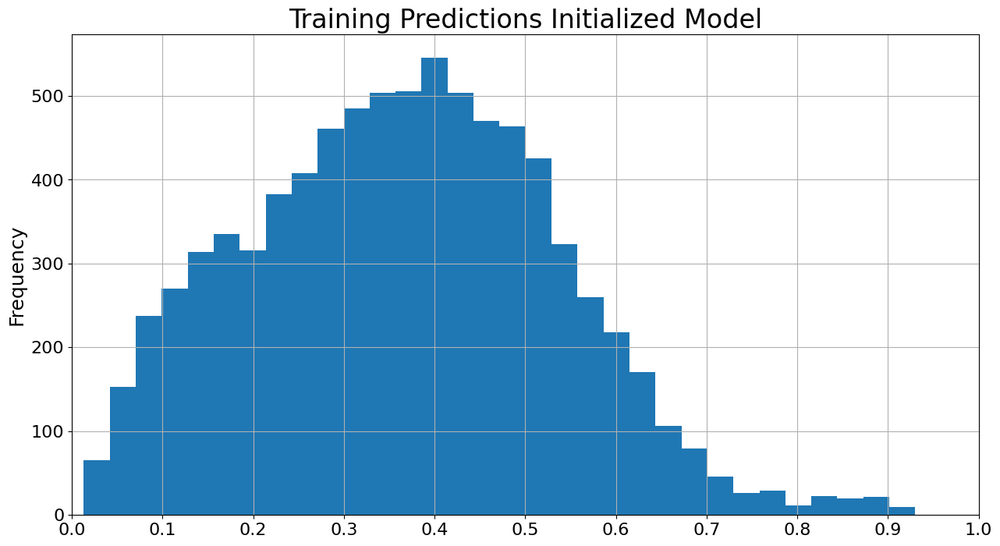

In [112]:
# Predictions on initialized model, shoudl be random and not saturated (all 0 or  all 1)
plt.figure(figsize=(15,8))
plt.title(f'Training Predictions Initialized Model')
pd.Series(train_preds).plot(kind='hist', bins=32)
plt.xticks(np.arange(0, 1.1, 0.1))
plt.xlim(0, 1)
plt.grid()
plt.show()

# Learning Rate Scheduler

In [113]:
# Learning rate scheduler with logaritmic warmup and cosine decay
def lrfn(current_step, num_warmup_steps, lr_max, num_cycles=0.50, num_training_steps=N_EPOCHS):
    
    if current_step < num_warmup_steps:
        return lr_max * 0.10 ** (num_warmup_steps - current_step)
    else:
        progress = float(current_step - num_warmup_steps) / float(max(1, num_training_steps - num_warmup_steps))

        return max(0.0, 0.5 * (1.0 + math.cos(math.pi * float(num_cycles) * 2.0 * progress))) * lr_max

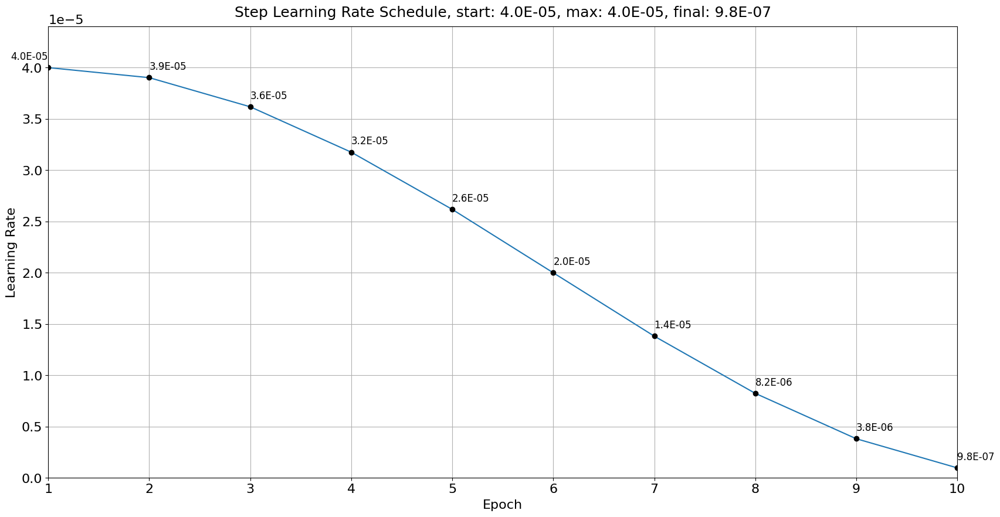

In [114]:
# Plot the learning rate scheduler
def plot_lr_schedule(lr_schedule, epochs):
    fig = plt.figure(figsize=(20, 10))
    plt.plot([None] + lr_schedule + [None])
    # X Labels
    x = np.arange(1, epochs + 1)
    x_axis_labels = [i if epochs <= 40 or i % 5 == 0 or i == 1 else None for i in range(1, epochs + 1)]
    plt.xlim([1, epochs])
    plt.xticks(x, x_axis_labels) # set tick step to 1 and let x axis start at 1
    
    # Increase y-limit for better readability
    plt.ylim([0, max(lr_schedule) * 1.1])
    
    # Title
    schedule_info = f'start: {lr_schedule[0]:.1E}, max: {max(lr_schedule):.1E}, final: {lr_schedule[-1]:.1E}'
    plt.title(f'Step Learning Rate Schedule, {schedule_info}', size=18, pad=12)
    
    # Plot Learning Rates
    for x, val in enumerate(lr_schedule):
        if epochs <= 40 or x % 5 == 0 or x is epochs - 1:
            if x < len(lr_schedule) - 1:
                if lr_schedule[x - 1] < val:
                    ha = 'right'
                else:
                    ha = 'left'
            elif x == 0:
                ha = 'right'
            else:
                ha = 'left'
            plt.plot(x + 1, val, 'o', color='black');
            offset_y = (max(lr_schedule) - min(lr_schedule)) * 0.02
            plt.annotate(f'{val:.1E}', xy=(x + 1, val + offset_y), size=12, ha=ha)
    
    plt.xlabel('Epoch', size=16, labelpad=5)
    plt.ylabel('Learning Rate', size=16, labelpad=5)
    plt.grid()
    plt.show()

# Learning rate for encoder
LR_SCHEDULE = [lrfn(step, num_warmup_steps=N_WARMUP_EPOCHS, lr_max=LR_MAX, num_cycles=0.50) for step in range(N_EPOCHS)]
plot_lr_schedule(LR_SCHEDULE, epochs=N_EPOCHS)

In [115]:
# Learning Rate Callback
lr_callback = tf.keras.callbacks.LearningRateScheduler(lambda step: LR_SCHEDULE[step], verbose=0)

# Weight Decay Callback

In [116]:
# Tensorflow Learning Rate Scheduler does not update weight decay, need to do it manually in a custom callback
class WeightDecayCallback(tf.keras.callbacks.Callback):
    def __init__(self, wd_ratio=WD_RATIO):
        self.step_counter = 0
        self.wd_ratio = wd_ratio
    
    def on_epoch_begin(self, epoch, logs=None):
        model.optimizer.weight_decay = model.optimizer.learning_rate * self.wd_ratio
        print(f'learning rate: {model.optimizer.learning_rate.numpy():.2e}, weight decay: {model.optimizer.weight_decay.numpy():.2e}')

# Training

In [117]:
# Train model on TPU!
history = model.fit(
        train_dataset,
        steps_per_epoch = TRAIN_STEPS_PER_EPOCH,
        validation_data = val_dataset,
        epochs = N_EPOCHS,
        verbose = VERBOSE,
        callbacks = [
            lr_callback,
            WeightDecayCallback(),
        ],
        class_weight = {
            0: 1.0,
            1: 5.0,
        },
    )

Epoch 1/10
learning rate: 4.00e-05, weight decay: 4.00e-07
685/685 [==============================] - 1603s 2s/step - loss: 0.6341 - pF1: 0.1543 - f1_score: 0.2291 - precision: 0.2211 - recall: 0.2377 - auc: 0.6946 - binary_accuracy: 0.9033 - val_loss: 0.1233 - val_pF1: 0.1340 - val_f1_score: 0.2394 - val_precision: 0.2226 - val_recall: 0.2588 - val_auc: 0.8242 - val_binary_accuracy: 0.9657


2023-02-22 05:51:07.880701: W ./tensorflow/core/distributed_runtime/eager/destroy_tensor_handle_node.h:57] Ignoring an error encountered when deleting remote tensors handles: Invalid argument: Unable to find the relevant tensor remote_handle: Op ID: 36973, Output num: 4
Additional GRPC error information from remote target /job:worker/replica:0/task:0:
:{"created":"@1677045067.880577316","description":"Error received from peer ipv4:10.0.0.2:8470","file":"external/com_github_grpc_grpc/src/core/lib/surface/call.cc","file_line":1056,"grpc_message":"Unable to find the relevant tensor remote_handle: Op ID: 36973, Output num: 4","grpc_status":3}


Epoch 2/10
learning rate: 3.90e-05, weight decay: 3.90e-07
685/685 [==============================] - 1483s 2s/step - loss: 0.4577 - pF1: 0.2869 - f1_score: 0.4597 - precision: 0.3981 - recall: 0.5439 - auc: 0.8621 - binary_accuracy: 0.9229 - val_loss: 0.2128 - val_pF1: 0.1164 - val_f1_score: 0.2262 - val_precision: 0.1486 - val_recall: 0.4737 - val_auc: 0.8177 - val_binary_accuracy: 0.9325
Epoch 3/10
learning rate: 3.62e-05, weight decay: 3.62e-07
685/685 [==============================] - 1484s 2s/step - loss: 0.3313 - pF1: 0.4115 - f1_score: 0.6027 - precision: 0.5296 - recall: 0.6992 - auc: 0.9289 - binary_accuracy: 0.9446 - val_loss: 0.1086 - val_pF1: 0.1742 - val_f1_score: 0.2981 - val_precision: 0.2936 - val_recall: 0.3026 - val_auc: 0.8134 - val_binary_accuracy: 0.9703
Epoch 4/10
learning rate: 3.18e-05, weight decay: 3.18e-07
685/685 [==============================] - 1481s 2s/step - loss: 0.2325 - pF1: 0.5369 - f1_score: 0.7024 - precision: 0.6259 - recall: 0.8003 - auc: 0.96

In [118]:
# Save model weights for inference
model.save_weights('model.h5')

# F1 By Threshold

In [119]:
# Get true labels and predictions for validation set
y_true_val = []
y_pred_val = []
for X_batch, y_batch in tqdm(get_dataset(TFRECORDS_VAL, val=True), total=VAL_STEPS_PER_EPOCH):
    y_true_val += y_batch.numpy().tolist()
    y_pred_val += model.predict_on_batch(X_batch).squeeze().tolist()

  0%|          | 0/171 [00:00<?, ?it/s]

2023-02-22 09:36:10.081694: W ./tensorflow/core/distributed_runtime/eager/destroy_tensor_handle_node.h:57] Ignoring an error encountered when deleting remote tensors handles: Invalid argument: Unable to find the relevant tensor remote_handle: Op ID: 180637, Output num: 0
Additional GRPC error information from remote target /job:worker/replica:0/task:0:
:{"created":"@1677058570.080860270","description":"Error received from peer ipv4:10.0.0.2:8470","file":"external/com_github_grpc_grpc/src/core/lib/surface/call.cc","file_line":1056,"grpc_message":"Unable to find the relevant tensor remote_handle: Op ID: 180637, Output num: 0","grpc_status":3}


In [120]:
# source: https://www.kaggle.com/code/sohier/probabilistic-f-score
# Competition Leaderboard Metric
def pfbeta(labels, predictions, beta=1):
    y_true_count = 0
    ctp = 0
    cfp = 0

    for idx in range(len(labels)):
        prediction = min(max(predictions[idx], 0), 1)
        if (labels[idx]):
            y_true_count += 1
            ctp += prediction
        else:
            cfp += prediction

    beta_squared = beta * beta
    c_precision = ctp / (ctp + cfp)
    c_recall = ctp / y_true_count
    if (c_precision > 0 and c_recall > 0):
        result = (1 + beta_squared) * (c_precision * c_recall) / (beta_squared * c_precision + c_recall)
        return result
    else:
        return 0

  0%|          | 0/101 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in long_scalars


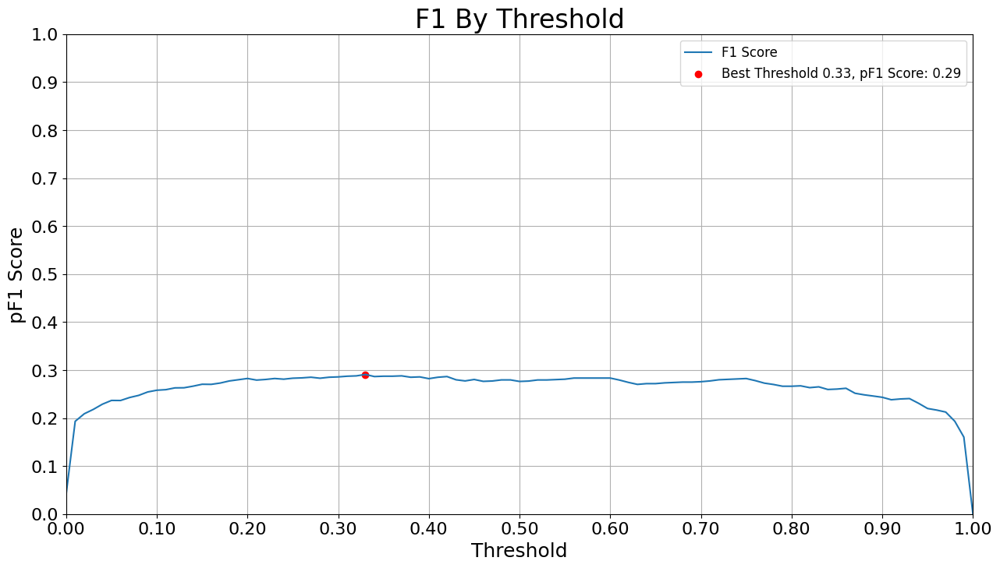

In [121]:
# Plot pF1 by threshold plot to find best threshold
pf1_by_threshold = []
thresholds = np.arange(0, 1.01, 0.01)
for t in tqdm(thresholds):
    # Compute pF1 for each threshold
    pf1_by_threshold.append(
        pfbeta(y_true_val, y_pred_val > t)
    )
    
plt.figure(figsize=(15,8))
plt.title('F1 By Threshold', size=24)
plt.plot(pf1_by_threshold, label='F1 Score')

# Best threshold and pF1 score
arg_max = np.argmax(pf1_by_threshold)
val_max = np.max(pf1_by_threshold)
threshold_best = thresholds[arg_max]
plt.scatter(arg_max, val_max, color='red', label=f'Best Threshold {threshold_best:.2f}, pF1 Score: {val_max:.2f}')

# Plot pF1 by Threshold
plt.xticks(np.arange(0, 110, 10), [f'{t:.2f}' for t in np.arange(0, 1.1, 0.1)])
plt.yticks(np.arange(0, 1.1, 0.1))
plt.xlim(0, 100)
plt.ylim(0, 1)
plt.xlabel('Threshold')
plt.ylabel('pF1 Score')
plt.legend(fontsize=12)
plt.grid()
plt.show()

# Training History

In [122]:
def plot_history_metric(metric, f_best=np.argmax, ylim=None, yscale=None, yticks=None):
    plt.figure(figsize=(20, 10))
    
    values = history.history[metric]
    N_EPOCHS = len(values)
    val = 'val' in ''.join(history.history.keys())
    # Epoch Ticks
    if N_EPOCHS <= 20:
        x = np.arange(1, N_EPOCHS + 1)
    else:
        x = [1, 5] + [10 + 5 * idx for idx in range((N_EPOCHS - 10) // 5 + 1)]

    x_ticks = np.arange(1, N_EPOCHS+1)

    # Validation
    if val:
        val_values = history.history[f'val_{metric}']
        val_argmin = f_best(val_values)
        plt.plot(x_ticks, val_values, label=f'val')

    # summarize history for accuracy
    plt.plot(x_ticks, values, label=f'train')
    argmin = f_best(values)
    plt.scatter(argmin + 1, values[argmin], color='red', s=75, marker='o', label=f'train_best')
    if val:
        plt.scatter(val_argmin + 1, val_values[val_argmin], color='purple', s=75, marker='o', label=f'val_best')

    plt.title(f'Model {metric}', fontsize=24, pad=10)
    plt.ylabel(metric, fontsize=20, labelpad=10)

    if ylim:
        plt.ylim(ylim)

    if yscale is not None:
        plt.yscale(yscale)
        
    if yticks is not None:
        plt.yticks(yticks, fontsize=16)

    plt.xlabel('epoch', fontsize=20, labelpad=10)        
    plt.tick_params(axis='x', labelsize=8)
    plt.xticks(x, fontsize=16) # set tick step to 1 and let x axis start at 1
    plt.yticks(fontsize=16)
    
    plt.legend(prop={'size': 10})
    plt.grid()
    plt.show()

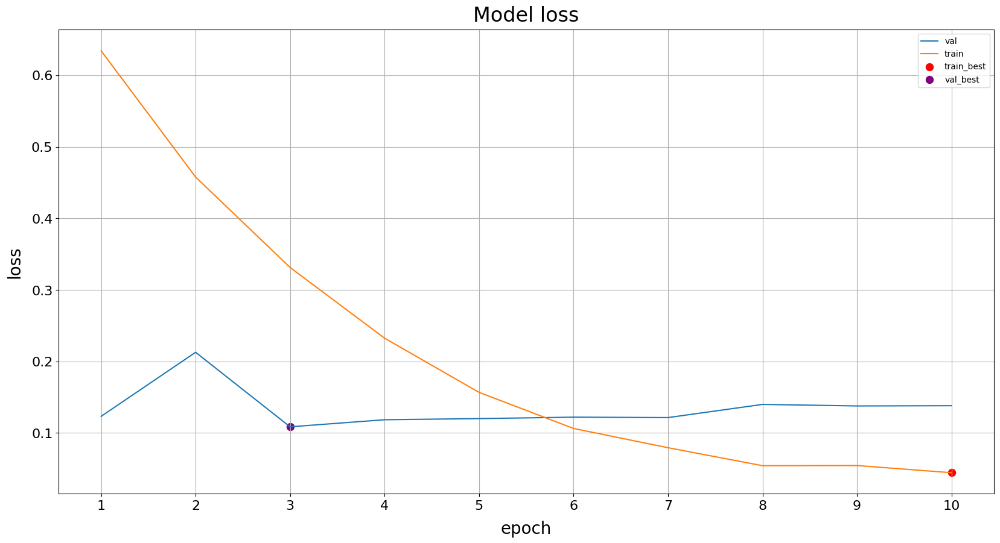

In [151]:
plot_history_metric('loss', f_best=np.argmin)

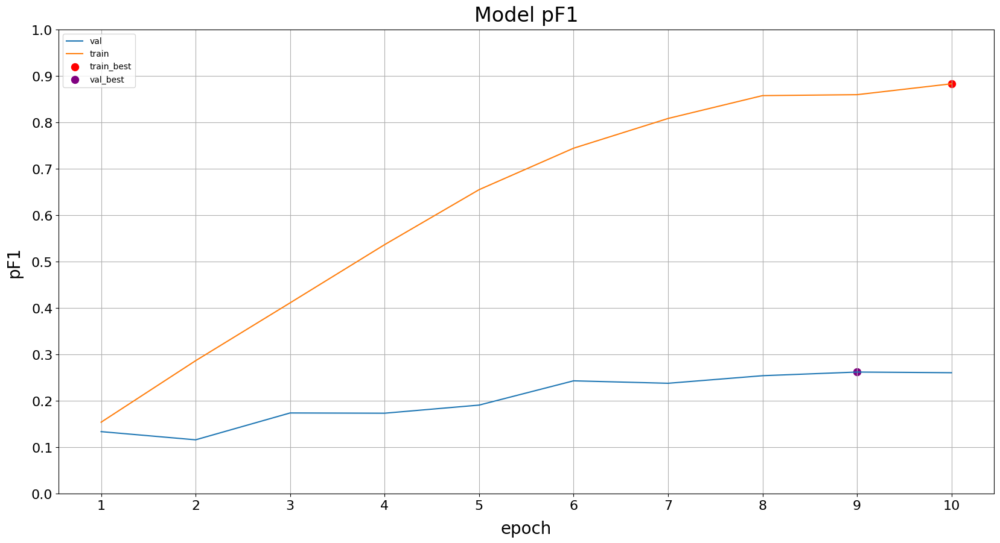

In [152]:
plot_history_metric('pF1', ylim=[0,1], yticks=np.arange(0.0, 1.1, 0.1))

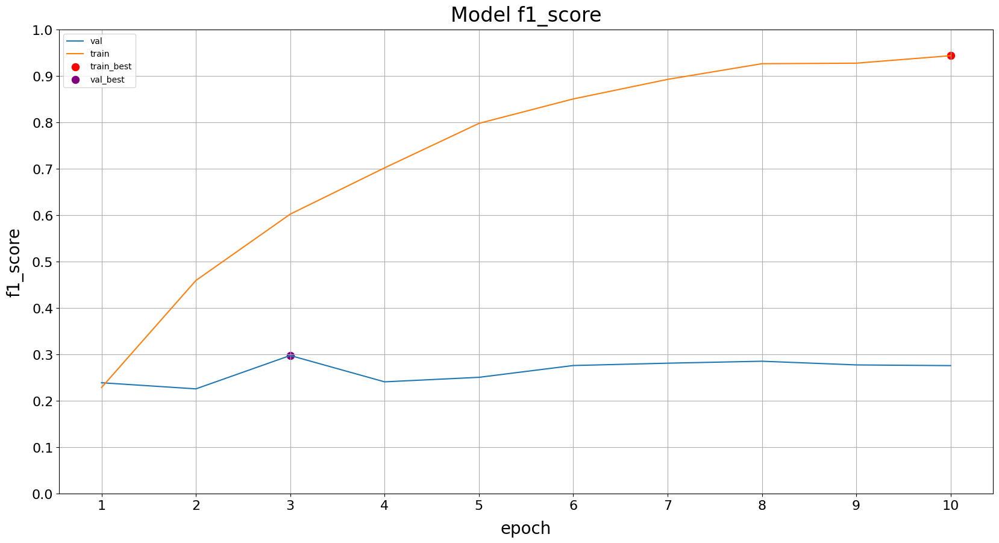

In [153]:
plot_history_metric('f1_score', ylim=[0,1], yticks=np.arange(0.0, 1.1, 0.1))

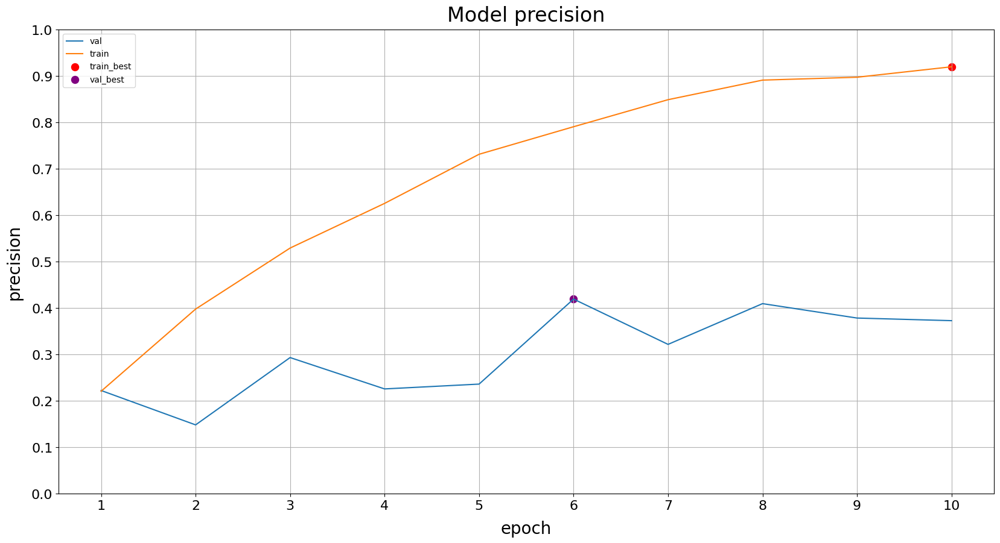

In [154]:
plot_history_metric('precision', ylim=[0,1], yticks=np.arange(0.0, 1.1, 0.1))

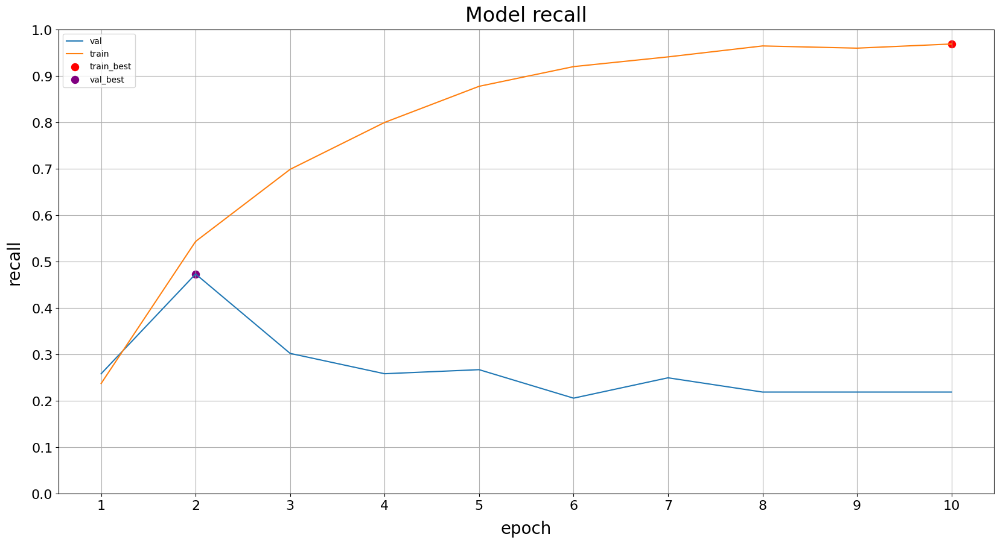

In [155]:
plot_history_metric('recall', ylim=[0,1], yticks=np.arange(0.0, 1.1, 0.1))

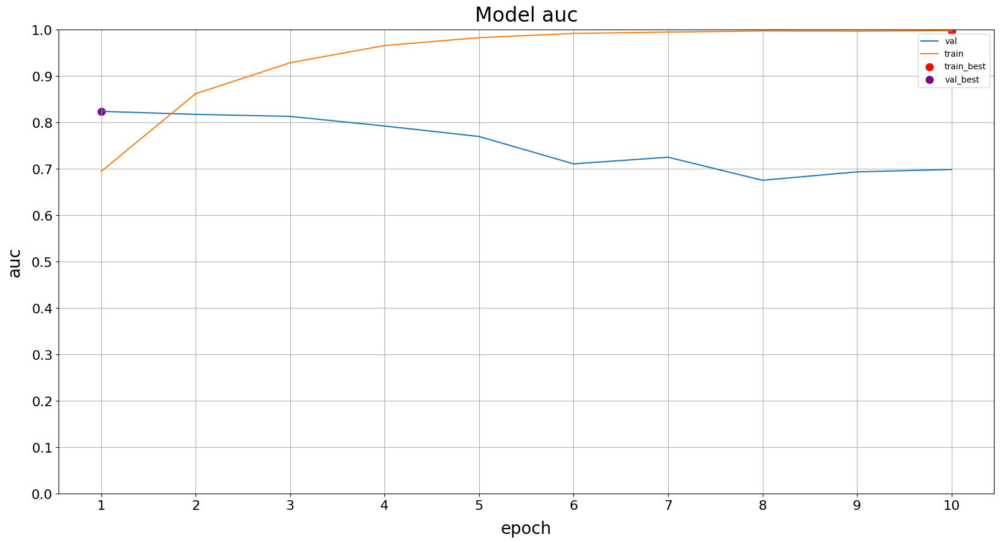

In [156]:
plot_history_metric('auc', ylim=[0,1], yticks=np.arange(0.0, 1.1, 0.1))

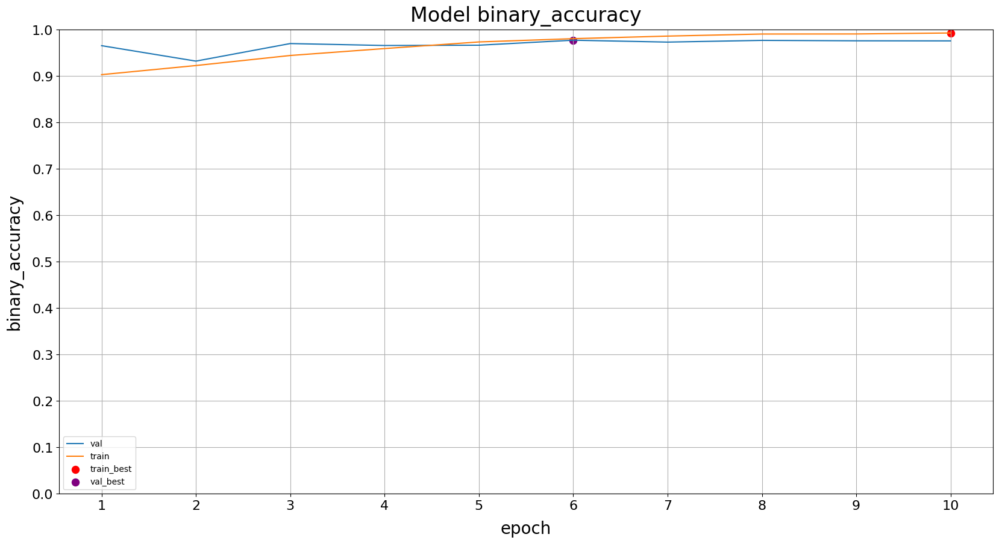

In [157]:
plot_history_metric('binary_accuracy', ylim=[0,1], yticks=np.arange(0.0, 1.1, 0.1))

# Inference

The inference process consists of 2 steps.

1) Preprocess and save all images in parallel, images are cropped, padded to correct aspect ratio and resized to the target size.

2) Prediction on preprocessed images in a simple loop, final cancer score is mean of all images.

In [158]:
%%capture
# Source: https://www.kaggle.com/code/remekkinas/fast-dicom-processing-1-6-2x-faster?scriptVersionId=113360473
!pip install /kaggle/input/rsnamodules/dicomsdl-0.109.1-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.whl 

try:
    import pylibjpeg
except:
   !pip install /kaggle/input/rsna-2022-whl/{pylibjpeg-1.4.0-py3-none-any.whl,python_gdcm-3.0.15-cp37-cp37m-manylinux_2_17_x86_64.manylinux2014_x86_64.whl}

In [160]:
# Install Keras CV Attention Model Pip Package for ConvNextV2 Models
!pip install --no-deps /kaggle/input/keras-cv-attention-models/keras_cv_attention_models-1.3.5-py3-none-any.whl

Processing /kaggle/input/keras-cv-attention-models/keras_cv_attention_models-1.3.5-py3-none-any.whl
keras-cv-attention-models is already installed with the same version as the provided wheel. Use --force-reinstall to force an installation of the wheel.


In [161]:
import numpy as np
import pandas as pd
import pylibjpeg
import pydicom
import matplotlib as mpl
import matplotlib.pyplot as plt
import tensorflow as tf

from joblib import Parallel, delayed
from tqdm.notebook import tqdm
from multiprocessing import cpu_count
from keras_cv_attention_models import convnext

import cv2
import glob
import importlib
import os
import joblib
import time
import dicomsdl
import gc

# Tensorflow and CV2 set number of threads to 1 for speedup in parallell function mapping
tf.config.threading.set_inter_op_parallelism_threads(num_threads=1)
cv2.setNumThreads(1)

# Pandas DataFrame Display Options
pd.options.display.max_colwidth = 99

# Config

In [163]:
IS_INTERACTIVE = os.environ['KAGGLE_KERNEL_RUN_TYPE'] == 'Interactive'

TARGET_HEIGHT = 1344
TARGET_WIDTH = 768
N_CHANNELS = 1
INPUT_SHAPE = (TARGET_HEIGHT, TARGET_WIDTH, N_CHANNELS)
TARGET_HEIGHT_WIDTH_RATIO = TARGET_HEIGHT / TARGET_WIDTH
THRESHOLD_BEST = 0.50

CLAHE = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(32, 32))

CROP_IMAGE = True
APPLY_CLAHE = False
APPLY_EQ_HIST = False

IMAGE_FORMAT = 'jpg'

# VOI LUT

In [164]:
# Source: https://www.kaggle.com/code/bobdegraaf/dicomsdl-voi-lut
def voi_lut(image, dicom):
    # Additional Checks
    if 'WindowWidth' not in dicom.getPixelDataInfo() or 'WindowWidth' not in dicom.getPixelDataInfo():
        return image
    
    # Load only the variables we need
    center = dicom['WindowCenter']
    width = dicom['WindowWidth']
    bits_stored = dicom['BitsStored']
    voi_lut_function = dicom['VOILUTFunction']

    # For sigmoid it's a list, otherwise a single value
    if isinstance(center, list):
        center = center[0]
    if isinstance(width, list):
        width = width[0]

    # Set y_min, max & range
    y_min = 0
    y_max = float(2**bits_stored - 1)
    y_range = y_max

    # Function with default LINEAR (so for Nan, it will use linear)
    if voi_lut_function == 'SIGMOID':
        image = y_range / (1 + np.exp(-4 * (image - center) / width)) + y_min
    else:
        # Checks width for < 1 (in our case not necessary, always >= 750)
        center -= 0.5
        width -= 1

        below = image <= (center - width / 2)
        above = image > (center + width / 2)
        between = np.logical_and(~below, ~above)

        image[below] = y_min
        image[above] = y_max
        if between.any():
            image[between] = (
                ((image[between] - center) / width + 0.5) * y_range + y_min
            )

    return image

# Crop Image

In [165]:
# Smooth vector used to smoothen sums/stds of axes
def smooth(l):
    # kernel size is 1% of vector
    kernel_size = int(len(l) * 0.01)
    kernel = np.ones(kernel_size) / kernel_size
    return np.convolve(l, kernel, mode='same')

# X Crop offset based on first column with sum below 5% of maximum column sums*std
def get_x_offset(image, max_col_sum_ratio_threshold=0.05, debug=None):
    # Image Dimensions
    H, W = image.shape
    # Percentual margin added to offset
    margin = int(image.shape[1] * 0.00)
    # Threshold values based on smoothed sum x std to capture varying intensity columns
    vv = smooth(image.sum(axis=0).squeeze()) * smooth(image.std(axis=0).squeeze())
    # Find maximum sum in first 75% of columns
    vv_argmax = vv[:int(image.shape[1] * 0.75)].argmax()
    # Threshold value
    vv_threshold = vv.max() * max_col_sum_ratio_threshold
    
    # Find first column after maximum column below threshold value
    for offset, v in enumerate(vv):
        # Start searching from vv_argmax
        if offset < vv_argmax:
            continue
        
        # Column below threshold value found
        if v < vv_threshold:
            offset = min(W, offset + margin)
            break
            
    if isinstance(debug, np.ndarray):
        debug[1].imshow(image)
        debug[1].set_title('X Offset')
        vv_scale = H / vv.max() * 0.90
        # Values
        debug[1].plot(H - vv * vv_scale , c='red', label='vv')
        # Threshold
        debug[1].hlines(H - vv_threshold * vv_scale, 0, W -1, colors='orange', label='threshold')
        # Max Value
        debug[1].scatter(vv_argmax, H - vv[vv_argmax] * vv_scale, c='blue', s=100, label='Max', zorder=np.PINF)
        # First Column Below Threshold
        debug[1].scatter(offset, H - vv[offset] * vv_scale, c='purple', s=100, label='Offset', zorder=np.PINF)
        debug[1].set_ylim(H, 0)
        debug[1].legend()
        debug[1].axis('off')
        
    return offset

# Y Crop offset based on first bottom and top rows with sum below 10% of maximum row sum*std
def get_y_offsets(image, max_row_sum_ratio_threshold=0.10, debug=None):
    # Image Dimensions
    H, W = image.shape
    # Margin to add to offsets
    margin = 0
    # Threshold values based on smoothed sum x std to capture varying intensity columns
    vv = smooth(image.sum(axis=1).squeeze()) * smooth(image.std(axis=1).squeeze())
    # Find maximum sum * std row in inter quartile rows
    vv_argmax = int(image.shape[0] * 0.25) + vv[int(image.shape[0] * 0.25):int(image.shape[0] * 0.75)].argmax()
    # Threshold value
    vv_threshold = vv.max() * max_row_sum_ratio_threshold
    # Default crop offsets
    offset_bottom = 0
    offset_top = H

    # Bottom offset, search from argmax to bottom
    for offset in reversed(range(0, vv_argmax)):
        v = vv[offset]
        if v < vv_threshold:
            offset_bottom = offset
            break
    
    if isinstance(debug, np.ndarray):
        debug[2].imshow(image)
        debug[2].set_title('Y Bottom Offset')
        vv_scale = W / vv.max() * 0.90
        # Values
        debug[2].plot(vv * vv_scale, np.arange(H), c='red', label='vv')
        # Threshold
        debug[2].vlines(vv_threshold * vv_scale, 0, H -1, colors='orange', label='threshold')
        # Max Value
        debug[2].scatter(vv[vv_argmax] * vv_scale, vv_argmax, c='blue', s=100, label='Max', zorder=np.PINF)
        # First Column Below Threshold
        debug[2].scatter(vv[offset_bottom] * vv_scale, offset_bottom, c='purple', s=100, label='Offset', zorder=np.PINF)
        debug[2].set_ylim(H, 0)
        debug[2].legend()
        debug[2].axis('off')
            
    # Top offset, search from argmax to top
    for offset in range(vv_argmax, H):
        v = vv[offset]
        if v < vv_threshold:
            offset_top = offset
            break
            
    if isinstance(debug, np.ndarray):
        debug[3].imshow(image)
        debug[3].set_title('Y Top Offset')
        vv_scale = W / vv.max() * 0.90
        # Values
        debug[3].plot(vv * vv_scale, np.arange(H) , c='red', label='vv')
        # Threshold
        debug[3].vlines(vv_threshold * vv_scale, 0, H -1, colors='orange', label='threshold')
        # Max Value
        debug[3].scatter(vv[vv_argmax] * vv_scale, vv_argmax, c='blue', s=100, label='Max', zorder=np.PINF)
        # First Column Below Threshold
        debug[3].scatter(vv[offset_top] * vv_scale, offset_top, c='purple', s=100, label='Offset', zorder=np.PINF)
        debug[2].set_ylim(H, 0)
        debug[3].legend()
        debug[3].axis('off')
            
    return max(0, offset_bottom - margin), min(image.shape[0], offset_top + margin)

# Crop image and pad offsets to target image height/width ratio to preserve information
def crop(image, size=None, debug=False):
    # Image dimensions
    H, W = image.shape
    # Compute x/bottom/top offsets
    x_offset = get_x_offset(image, debug=debug)
    offset_bottom, offset_top = get_y_offsets(image[:,:x_offset], debug=debug)
    # Crop Height and Width
    h_crop = offset_top - offset_bottom
    w_crop = x_offset
    
    # Pad crop offsets to target aspect ratio
    if size is not None:
        # Height too large, pad x offset
        if (h_crop / w_crop) > TARGET_HEIGHT_WIDTH_RATIO:
            x_offset += int(h_crop / TARGET_HEIGHT_WIDTH_RATIO - w_crop)
        else:
            # Height too small, pad bottom/top offsets
            offset_bottom -= int(0.50 * (w_crop * TARGET_HEIGHT_WIDTH_RATIO - h_crop))
            offset_bottom_correction = max(0, -offset_bottom)
            offset_bottom += offset_bottom_correction

            offset_top += int(0.50 * (w_crop * TARGET_HEIGHT_WIDTH_RATIO - h_crop))
            offset_top += offset_bottom_correction
        
    # Crop Image
    image = image[offset_bottom:offset_top:,:x_offset]
        
    return image


# Process Image

In [166]:
def process(file_path, size=(TARGET_WIDTH, TARGET_HEIGHT), crop_image=CROP_IMAGE, apply_clahe=APPLY_CLAHE, apply_eq_hist=APPLY_EQ_HIST, debug=False, save=True):
    # Read Dicom File
    dicom = dicomsdl.open(file_path)
    image = dicom.pixelData()
    
    # Save original image for debug purposes
    if debug:
        fig, axes = plt.subplots(1, 5, figsize=(20,10))
        image0 = np.copy(image)
        axes[0].imshow(image0)
        axes[0].set_title('Original Image')
        axes[0].axis('off')
    else:
        axes = False
    
    # voi_lut
    try:
        image = voi_lut(image, dicom)
    except:
        pass
    
    # Some images have 0 values as highest intensity and need to be inverted
    if dicom.getPixelDataInfo()['PhotometricInterpretation'] == 'MONOCHROME1':
        image = np.max(image) - image

    # Normalize [0,1] range
    image = (image - image.min()) / (image.max() - image.min())

    # Convert to uint8 image in range [0, 255]
    image = (image * 255).astype(np.uint8)
    
    # Flip T0 Left/Right Orientation
    h0, w0 = image.shape
    if image[:,int(-w0 * 0.10):].sum() > image[:,:int(w0 * 0.10)].sum():
        image = np.flip(image, axis=1)
    
    # Crop Image
    if crop_image:
        image = crop(image, debug=axes)
        
    # Resize
    if size is not None:
        # Pad black pixels to make square image
        h, w = image.shape
        if (h / w) > TARGET_HEIGHT_WIDTH_RATIO:
            pad = int(h / TARGET_HEIGHT_WIDTH_RATIO - w)
            image = np.pad(image, [[0,0], [0, pad]])
            h, w = image.shape
        else:
            pad = int(0.50 * (w * TARGET_HEIGHT_WIDTH_RATIO - h))
            image = np.pad(image, [[pad, pad], [0,0]])
            h, w = image.shape
        # Resize
        image = cv2.resize(image, size, interpolation=cv2.INTER_AREA)
        
    # Apply CLAHE contrast enhancement
    if apply_clahe:
        image = CLAHE.apply(image)
        
     # Apply Histogram Equalization
    if apply_eq_hist:
        image = cv2.equalizeHist(image)
        
    # Show Processed Image    
    if debug:
        axes[4].imshow(image)
        axes[4].set_title('Processed Image')
        axes[4].axis('off')
        plt.show()
        
    # Save Only
    if save:
        image_id = file_path.split('/')[-1].split('.')[0]
        if IMAGE_FORMAT == 'png':
            cv2.imwrite(f'{image_id}.png', image)
        else:
            cv2.imwrite(f'{image_id}.jpg', image, [cv2.IMWRITE_JPEG_QUALITY, 95])

# Example Preprocessing

In [167]:
train = pd.read_csv('/kaggle/input/rsna-breast-cancer-detection/train.csv')
    
def get_file_path(args):
    patient_id, image_id = args
    return f'/kaggle/input/rsna-breast-cancer-detection/train_images/{patient_id}/{image_id}.dcm'
    
train['file_path'] = train[['patient_id', 'image_id']].apply(get_file_path, axis=1)

  0%|          | 0/8 [00:00<?, ?it/s]

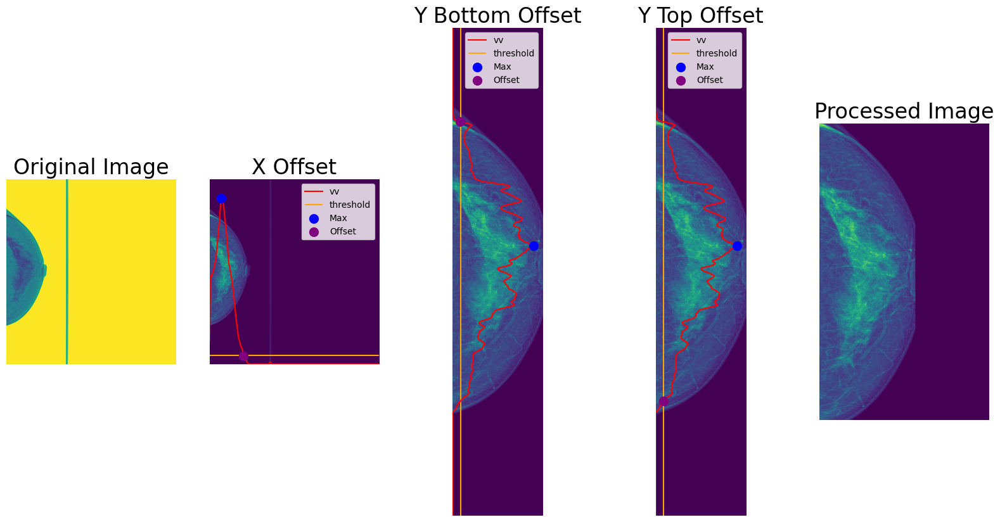

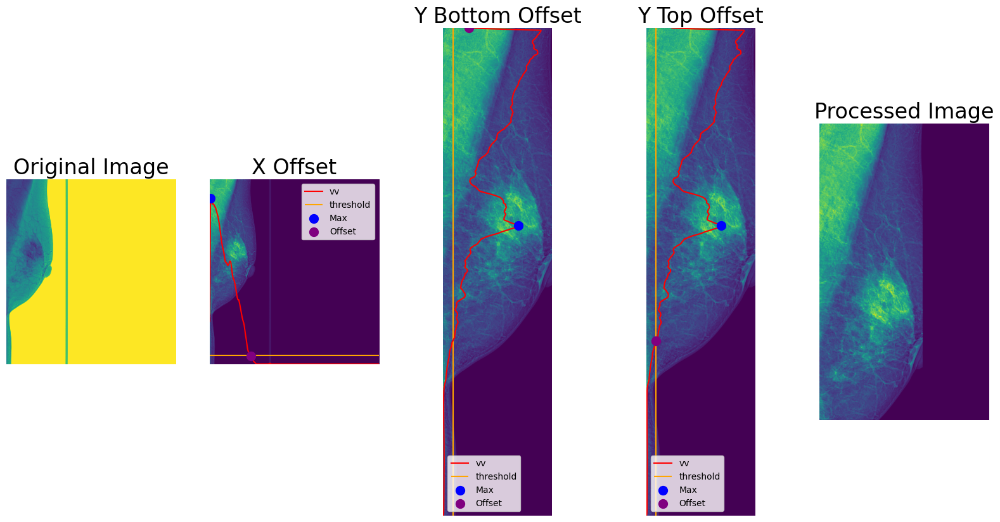

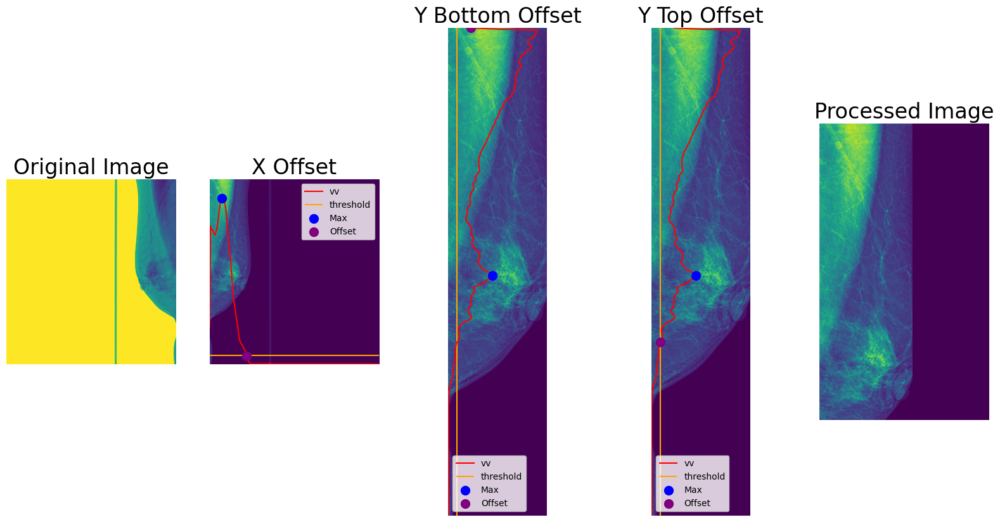

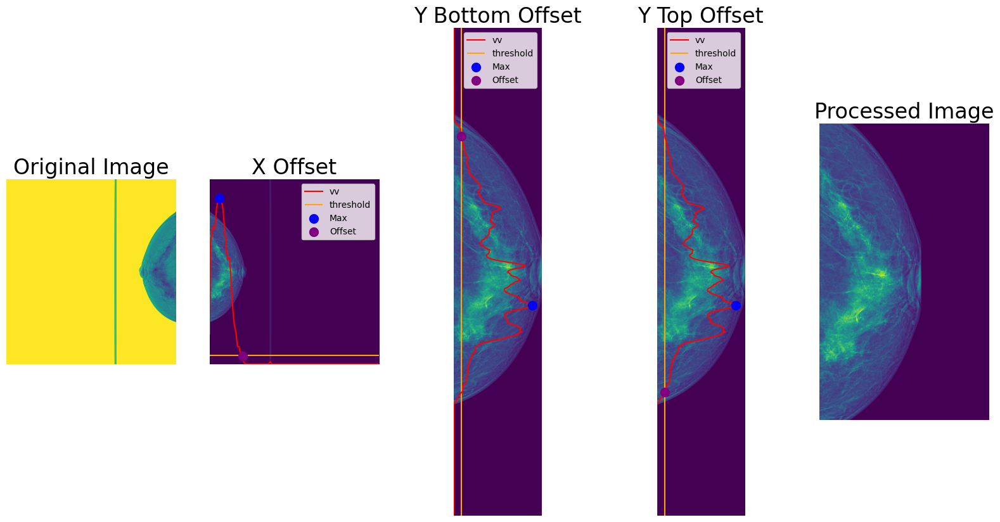

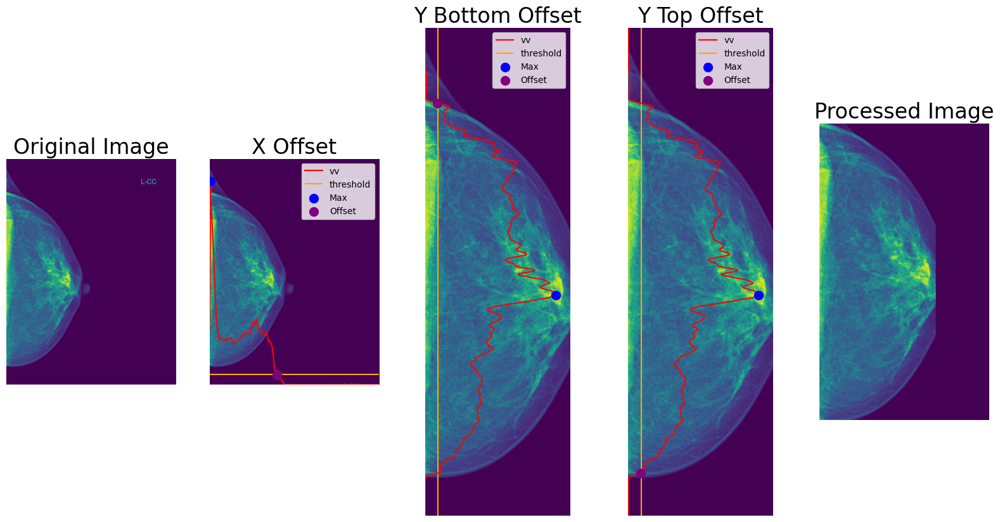

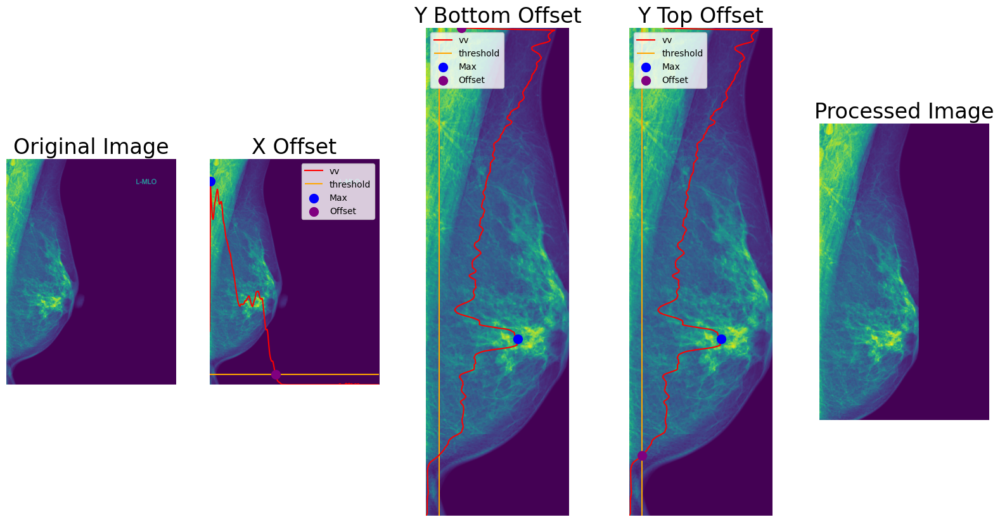

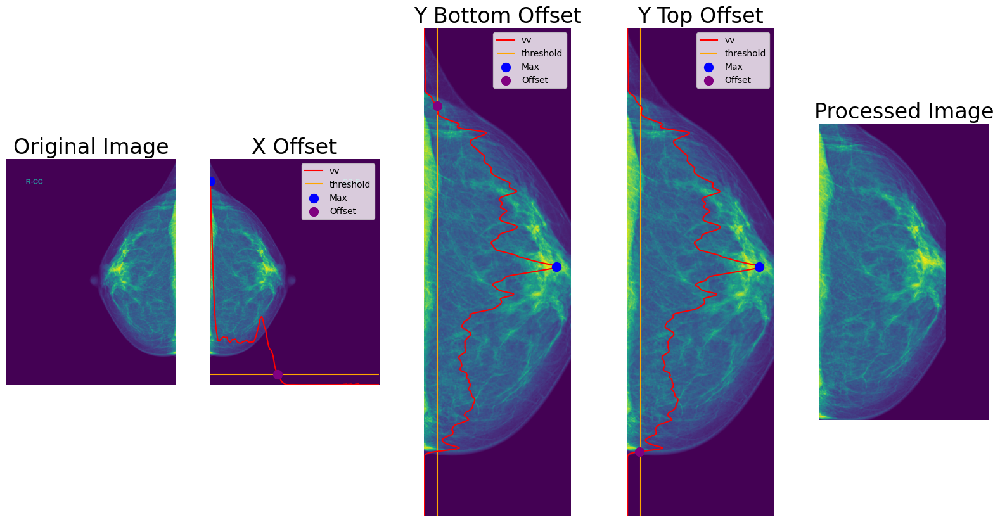

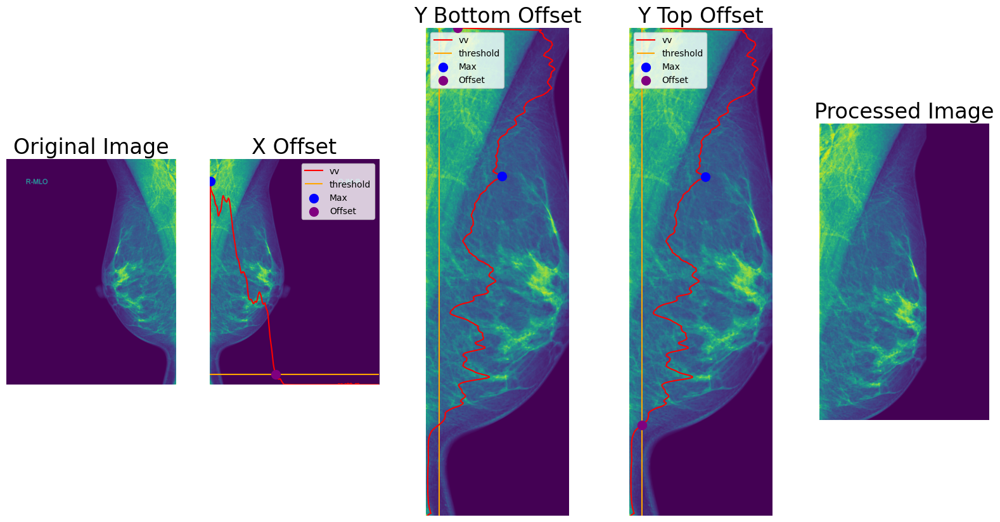

In [168]:
N = 8

for fp in tqdm(train['file_path'].head(N)):
    process(fp, crop_image=True, size=(TARGET_WIDTH, TARGET_HEIGHT), debug=True, save=False)


# Model

In [169]:
def normalize(image):
    # Repeat channels to create 3 channel images required by pretrained ConvNextV2 models
    image = tf.repeat(image, repeats=3, axis=3)
    # Cast to float 32
    image = tf.cast(image, tf.float32)
    # Normalize with respect to ImageNet mean/std
    image = tf.keras.applications.imagenet_utils.preprocess_input(image, mode='torch')

    return image

In [170]:
def get_model():
    # Inputs, note the names are equal to the dictionary keys in the dataset
    image = tf.keras.layers.Input(INPUT_SHAPE, name='image', dtype=tf.uint8)

    # Normalize Input
    image_norm = normalize(image)

    # CNN Feature Maps
    x = convnext.ConvNeXtV2Tiny(
        input_shape=(TARGET_HEIGHT, TARGET_WIDTH, 3),
        pretrained=None,
        num_classes=0,
    )(image_norm)

    # Average Pooling BxHxWxC -> BxC
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    # Dropout to prevent Overfitting
    x = tf.keras.layers.Dropout(0.30)(x)
    # Output value between [0, 1] using Sigmoid function
    outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)

    # Define model with inputs and outputs
    model = tf.keras.models.Model(inputs=image, outputs=outputs)

    # Load pretrained Model Weights
    model.load_weights('/kaggle/input/rsna-efficientnetv2-training-tensorflow-tpu-ds/model.h5')

    # Set model non-trainable
    model.trainable = False

    # Compile model
    model.compile()

    return model

In [171]:
# Pretrained File Path: '/kaggle/input/sartorius-training-dataset/model.h5'
tf.keras.backend.clear_session()
# enable XLA optmizations
tf.config.optimizer.set_jit(True)

model = get_model()

In [172]:
# Plot model summary
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
image (InputLayer)           [(None, 1344, 768, 1)]    0         
_________________________________________________________________
tf.repeat (TFOpLambda)       (None, 1344, 768, None)   0         
_________________________________________________________________
tf.cast (TFOpLambda)         (None, 1344, 768, None)   0         
_________________________________________________________________
tf.math.truediv (TFOpLambda) (None, 1344, 768, None)   0         
_________________________________________________________________
tf.nn.bias_add (TFOpLambda)  (None, 1344, 768, 3)      0         
_________________________________________________________________
tf.math.truediv_1 (TFOpLambd (None, 1344, 768, 3)      0         
_________________________________________________________________
convnext_v2_tiny (Functional (None, 42, 24, 768)       278649

# Test

In [173]:
test = pd.read_csv('/kaggle/input/rsna-breast-cancer-detection/test.csv')

def get_file_path(args):
    patient_id, image_id = args
    return f'/kaggle/input/rsna-breast-cancer-detection/test_images/{patient_id}/{image_id}.dcm'
    
test['file_path'] = test[['patient_id', 'image_id']].apply(get_file_path, axis=1)

display(test.info())
display(test.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4 entries, 0 to 3
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   site_id        4 non-null      int64 
 1   patient_id     4 non-null      int64 
 2   image_id       4 non-null      int64 
 3   laterality     4 non-null      object
 4   view           4 non-null      object
 5   age            4 non-null      int64 
 6   implant        4 non-null      int64 
 7   machine_id     4 non-null      int64 
 8   prediction_id  4 non-null      object
 9   file_path      4 non-null      object
dtypes: int64(6), object(4)
memory usage: 448.0+ bytes


None

,site_id,patient_id,image_id,laterality,view,age,implant,machine_id,prediction_id,file_path
0,2,10008,736471439,L,MLO,81,0,21,10008_L,/kaggle/input/rsna-breast-cancer-detection/test_images/10008/736471439.dcm
1,2,10008,1591370361,L,CC,81,0,21,10008_L,/kaggle/input/rsna-breast-cancer-detection/test_images/10008/1591370361.dcm
2,2,10008,68070693,R,MLO,81,0,21,10008_R,/kaggle/input/rsna-breast-cancer-detection/test_images/10008/68070693.dcm
3,2,10008,361203119,R,CC,81,0,21,10008_R,/kaggle/input/rsna-breast-cancer-detection/test_images/10008/361203119.dcm


# Sample Submission

In [174]:
sample_submission = pd.read_csv('/kaggle/input/rsna-breast-cancer-detection/sample_submission.csv')

display(sample_submission.info())
display(sample_submission.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2 entries, 0 to 1
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   prediction_id  2 non-null      object 
 1   cancer         2 non-null      float64
dtypes: float64(1), object(1)
memory usage: 160.0+ bytes


None

,prediction_id,cancer
0,10008_L,0.021168
1,10008_R,0.021168


# Parallel Image Processing

In [175]:
# Preprocess a single image and saves it
def preprocess_and_save_image(args):
    (patient_id, laterality), g = args
    cancer = 0.0
    for row_idx, row in g.iterrows():
        process(row['file_path'])

In [176]:
# Preprocess all images in parallel using Joblib
jobs = [joblib.delayed(preprocess_and_save_image)(args) for args in test.groupby(['patient_id', 'laterality'])]
SUBMISSION_ROWS = joblib.Parallel(
    n_jobs=cpu_count(),
    verbose=IS_INTERACTIVE,
    backend='multiprocessing',
    prefer='threads',
)(jobs)

[Parallel(n_jobs=4)]: Using backend MultiprocessingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   2 out of   2 | elapsed:    2.4s finished


# INFERENCE

  0%|          | 0/2 [00:00<?, ?it/s]

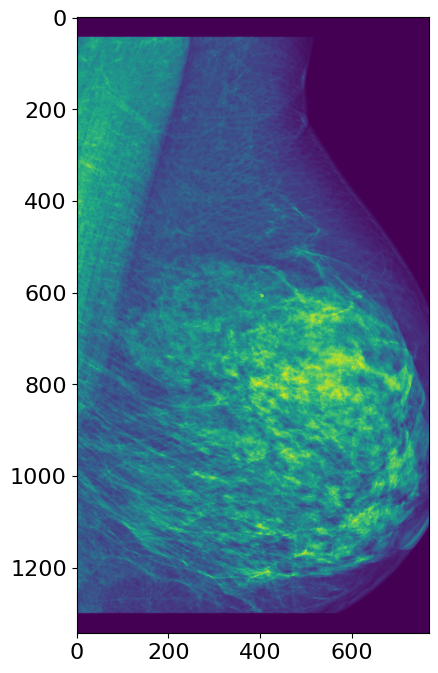

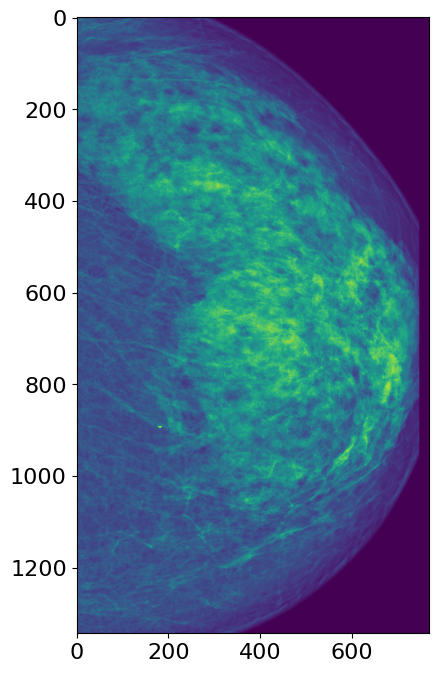

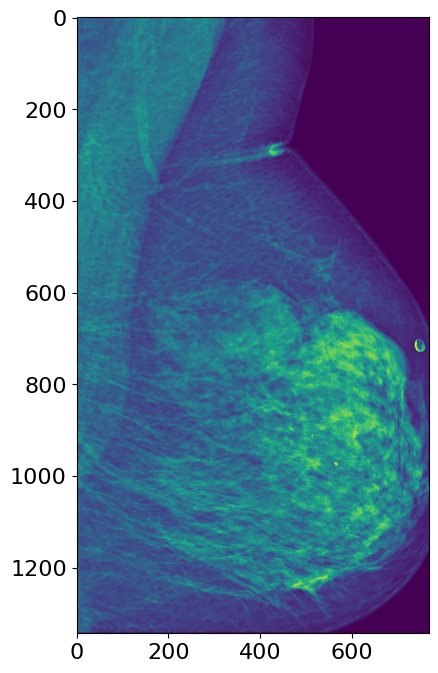

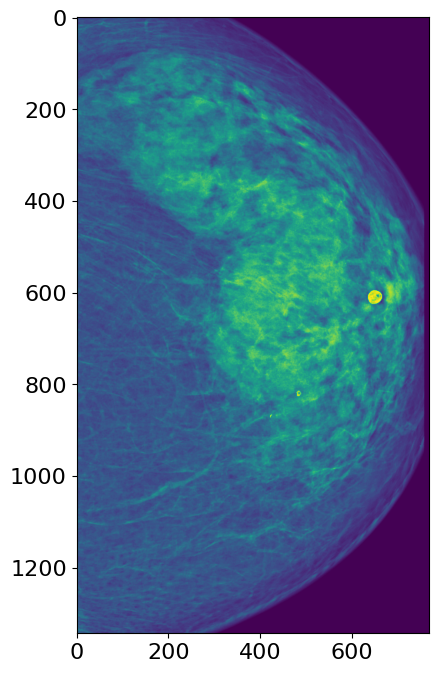

In [177]:
SUBMISSION_ROWS = []
# Iterate over all patient_id/laterality combinations groups
for idx, ((patient_id, laterality), g) in enumerate(tqdm(test.groupby(['patient_id', 'laterality']))):
    # Cancer target is mean of predicted cancer values
    cancer = 0
    # Iterate over all scans in group
    for row_idx, row in g.iterrows():
        # Load Image
        image_id = row['image_id']
        image = cv2.imread(f'{image_id}.{IMAGE_FORMAT}', -1)
        # Show First Few Images
        if idx < 16:
            plt.figure(figsize=(5,8))
            plt.imshow(image)
            plt.show()
        
        # Expand to Batch HxW -> 1xHxWx1
        image = np.expand_dims(image, [0, 3])
        # Make Prediction
        cancer += model.predict_on_batch(image).squeeze() / len(g)
        # Remove Image
        os.remove(f'{image_id}.{IMAGE_FORMAT}')
        
    # Add Submission Row
    SUBMISSION_ROWS.append({
        'prediction_id': f'{patient_id}_{laterality}',
        'cancer': np.int8(cancer > THRESHOLD_BEST),
    })
    
    if np.random.rand() > 0.99:
        gc.collect()

# Save Submission

In [178]:
# Create DataFrame from submission rows
submission_df = pd.DataFrame(SUBMISSION_ROWS)

display(submission_df.info())
display(submission_df.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2 entries, 0 to 1
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   prediction_id  2 non-null      object
 1   cancer         2 non-null      int8  
dtypes: int8(1), object(1)
memory usage: 146.0+ bytes


None

,prediction_id,cancer
0,10008_L,0
1,10008_R,0


In [179]:
# Save submission as CSV
submission_df.to_csv('submission.csv', index=False)

In [180]:
# Sanity Check
display(pd.read_csv('submission.csv').head())

,prediction_id,cancer
0,10008_L,0
1,10008_R,0
